In [1]:
import h5py
import numpy as np
import Functions.Binning as Bin
import Functions.Regressors as Rss
import copy
import importlib
import matplotlib.pyplot as plt
import Functions.AllFunctions as AllF
import Functions.Make_pandaBinsDataset as MPB
import pandas as pd
from scipy.signal import savgol_filter
import Functions.UnifyWormsFun as UNF
from scipy.signal import find_peaks
import Functions.Autocorr as Aut

/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster


In [2]:
h5  = h5py.File('MegaData7_8worms_V2.h5','r')#'MegaData7_7worms_V4.h5', 'r')#h5py.File('MegaData7_7worms_V2_correctLRorder.h5', 'r')

In [3]:
L= h5['data_sets_info/lowercam_length']
#n_title = [s.decode('utf-8') for s in list(h5['data_sets_info/neuron_names'])]
MegaData0 = np.copy(h5['data/dataraw'])
MegaData =copy.deepcopy(MegaData0)

In [4]:
listval = [v for v in h5['data/dataraw'].attrs.values()]
listkeys = [v for v in h5['data/dataraw'].attrs.keys()]
listkeys_ord = listkeys

Dictionary = {listval[v]:listkeys[v] for v in range(len(listkeys)-1)}
print(Dictionary[12])

lower_camera_time_stamp


In [6]:
smooth=True
gapfilled = True
numW=8

In [7]:
sm = [2,2,2,3,4,3,3,3]
g=[5,5,5,7,10,7,7,7]
sg=[5,5,5,7,11,7,7,7]
if smooth:
    for d in range(numW):
        for i in range(55):
            if not (i in [10,11,12]):
                MegaData[d,:L[d],i] = Bin.smooth_vec_long(MegaData0[d,:L[d],i],sm[d],g[d])

In [8]:
#the upper camera in the  6th movie starts late
for i in range(55):
    if i >12 and not (i in [27,28,39,40]):
        MegaData[5,:243,i] = 0
        MegaData0[5,:243,i] = 0

for i in range(55):
    MegaData[6,L[6]:,i] = 0
    MegaData0[6,L[6]:,i] = 0

In [9]:
MegaData_filled =copy.deepcopy(MegaData0)
importlib.reload(AllF)
if gapfilled:
    for d in range(numW):
        for i in range(55):
            if not (i in [10,11,12]):
                MegaData_filled[d,:L[d],i] = AllF.fill_in_gaps(MegaData0[d,:L[d],i],g[d])

MegaData_fs =copy.deepcopy(MegaData0)
if smooth and gapfilled:
    for d in range(numW):
        for i in range(55):
            if not (i in [10,11,12]):
                MegaData_fs[d,:L[d],i] = Bin.smooth_vec_long(MegaData_filled[d,:L[d],i],sm[d],g[d])

MegaData_filled[MegaData_filled==0] = np.nan
MegaData_interp = copy.deepcopy(MegaData_filled)
for d in range(numW):
    for n in range(55):
        if not (n in [10,11,12]):
            time = MegaData0[d,:L[d],12]
            values = MegaData_filled[d,:L[d],n]
            df = pd.DataFrame({'time': time, 'values': values})
            window_size = 3
            df['values2'] = df['values'].interpolate(method='linear')
            smoothed_values1 = savgol_filter(df['values2'], window_length=sg[d], polyorder=1)
            df['smoothed_values1'] = smoothed_values1
            MegaData_interp[d,:L[d],n] = smoothed_values1


MegaData_interp[np.isnan(MegaData_interp)]=0
MegaData_filled[np.isnan(MegaData_filled)]=0

In [10]:

importlib.reload(AllF)
Data0= copy.deepcopy(MegaData)

Data0[3,:,:] = MegaData_fs[3,:,:]

Data0[5,:,:] = MegaData_fs[5,:,:]
Deriv = AllF.compute_derivatives(Data0,sm,L,ZscoreList=[0,1,2,3,4,5,6,7,8,9,27,28,39,40],exclude_worm=[numW],
                            exclude_columns=[10,11,12,55,56,57,58,59])
Deriv2s = AllF.compute_derivatives(Data0,2*sm,L,ZscoreList=[0,1,2,3,4,5,6,7,8,9,27,28,39,40],exclude_worm=[numW],
                            exclude_columns=[10,11,12,55,56,57,58,59])
DerivFu = AllF.compute_derivatives_future(Data0,sm,L,ZscoreList=[0,1,2,3,4,5,6,7,8,9,27,28,39,40],exclude_worm=[numW],
                            exclude_columns=[10,11,12,55,56,57,58,59])
DerivFu2s = AllF.compute_derivatives_future(Data0,2*sm,L,ZscoreList=[0,1,2,3,4,5,6,7,8,9,27,28,39,40],exclude_worm=[numW],
                            exclude_columns=[10,11,12,55,56,57,58,59])

Deriv2 = AllF.compute_derivatives(Deriv,sm,L,ZscoreList=[0,1,2,3,4,5,6,7,8,9,27,28,39,40],exclude_worm=[numW],
                            exclude_columns=[10,11,12,55,56,57,58,59])

filtered_columns:
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54]
filtered_columns:
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54]


/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster/Functions/AllFunctions.py:334: RuntimeWarning: Mean of empty slice
  mean = np.nanmean(vector[np.nonzero(vector)[0]])
/home/mahsa/anaconda3/envs/Targettrack/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster/Functions/AllFunctions.py:275: RuntimeWarning: All-NaN slice encountered
  maxpos = np.nanmax(temp)
/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster/Functions/AllFunctions.py:276: RuntimeWarning: All-NaN slice encountered
  maxneg = -np.nanmin(temp)
/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster/Functions/AllFunctions.py:312: RuntimeWarning: All-NaN slice encountered
  maxpos = np.nanmax(temp)
/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster/Functions/AllFunctions.py:313: RuntimeWarning: All-NaN slice encountered
  maxneg = -np.nanmin(temp)


filtered_columns:
[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49, 50, 51, 52, 53, 54]


In [11]:
for r in [10,11,12]:
    Deriv[:,:,r] = MegaData0[:,:,r]
    Deriv2[:,:,r] = MegaData0[:,:,r]


In [12]:
#intervals of IAA and nonanone
IAA_int = np.zeros((numW,4))
NN_int = np.zeros((numW,4))
IAA_int[0,:] = [210,690,1775,2255]
IAA_int[1,:] = [210,690,1775,2255]
IAA_int[2,:] = [210,690,1775,2255]
IAA_int[3,:] = [210,690,1775,2255]
IAA_int[4,:] = [1,500,1575,2055]
NN_int[0,:] = [997,1477,2555,3040]
NN_int[1,:] = [997,1477,2555,3040]
NN_int[2,:] = [997,1477,2555,3040]
NN_int[3,:] = [997,1477,2555,3040]
NN_int[4,:] = [797,1277,2350,2840]
NN_int[5,:] = [957,1437,2520,3000]
IAA_int[5,:] = [177,657,1737,2240]

NN_int[6,:] = [1080,1560,2560,3000]
IAA_int[6,:] = [300,780,1780,2260]
NN_int[7,:] = [1080,1560,2560,3000]
IAA_int[7,:] = [300,780,1780,2260]
'''
# change the odor labels
for d in range(numW):
    nn1 = np.nonzero((MegaData0[d,:L[d],12]>950) & (MegaData0[d,:L[d],12]< 1550))
    for t in nn1[0]:
        if MegaData0[d,t,10]:
            MegaData0[d,t,10]=2
    nn1 = np.nonzero(MegaData0[d,:L[d],12]>2300)
    for t in nn1[0]:
        if MegaData0[d,t,10]:
            MegaData0[d,t,10]=2

'''

'\n# change the odor labels\nfor d in range(numW):\n    nn1 = np.nonzero((MegaData0[d,:L[d],12]>950) & (MegaData0[d,:L[d],12]< 1550))\n    for t in nn1[0]:\n        if MegaData0[d,t,10]:\n            MegaData0[d,t,10]=2\n    nn1 = np.nonzero(MegaData0[d,:L[d],12]>2300)\n    for t in nn1[0]:\n        if MegaData0[d,t,10]:\n            MegaData0[d,t,10]=2\n\n'

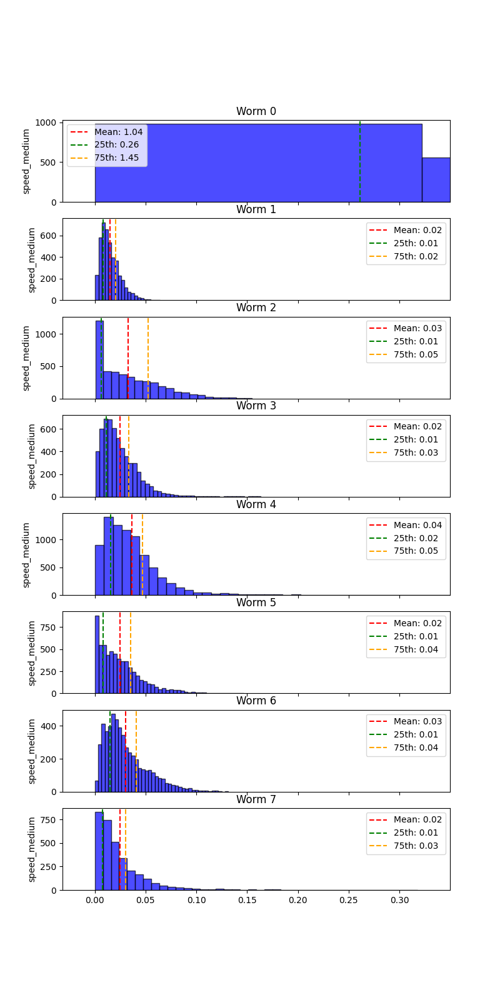

In [13]:
importlib.reload(AllF)
remove=np.zeros((numW,2))
remove[0,0]= 0.01
remove[0,1]= 0.01
columnToPlot =15
%matplotlib widget
fi,ax = AllF.plot_histogram_subplots(MegaData_interp[:numW,:,:],L,columnToPlot,perc=25,ylab='speed_medium',b=[20,20,20,40,40,40,40,40],
                                     removeTopBottom=remove)

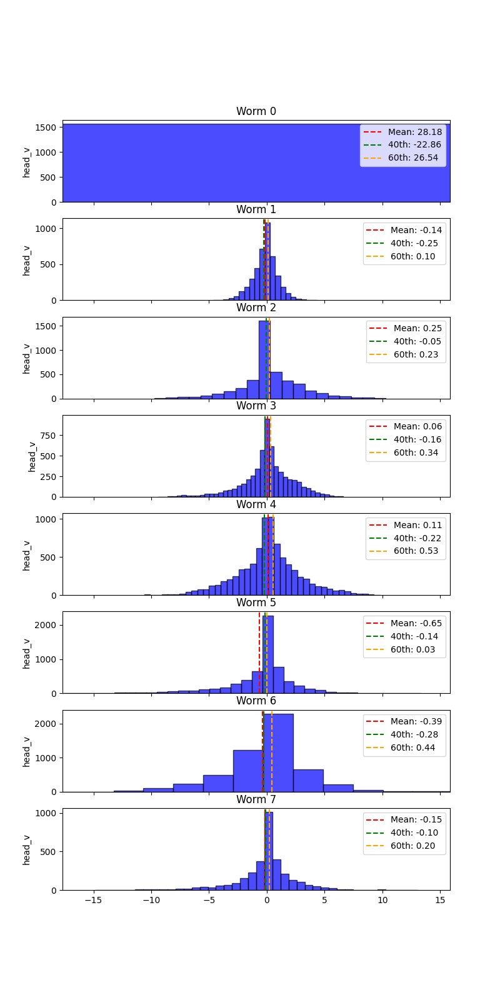

In [14]:
importlib.reload(AllF)
columnToPlot =22
remove=np.zeros((numW,2))
#remove[0,0]= 0.01
#remove[0,1]= 0.01

%matplotlib widget
fi,ax = AllF.plot_histogram_subplots(MegaData_interp[:numW,:,:]*100,L,columnToPlot,perc=40,ylab='head_v',b=[20,20,20,40,40,40,40,40],
                                     removeTopBottom=remove)

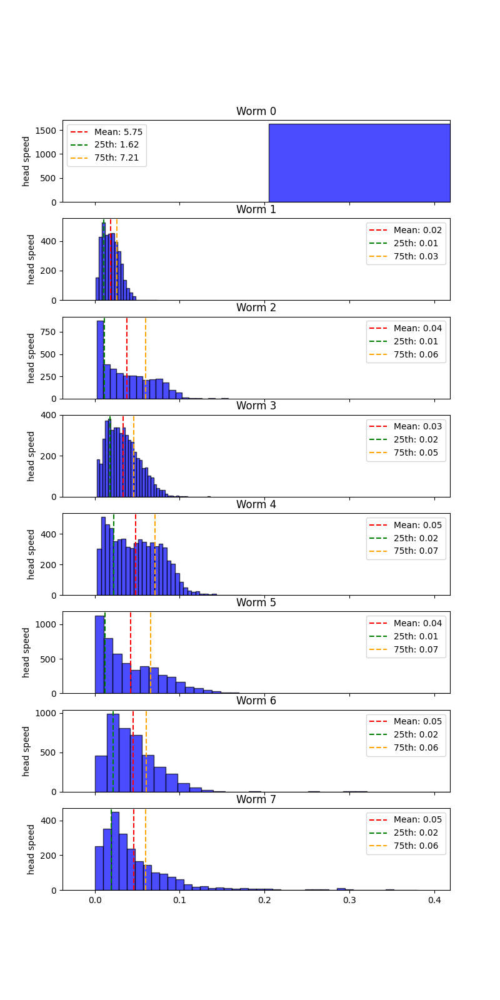

(<Figure size 800x1600 with 8 Axes>,
 array([<Axes: title={'center': 'Worm 0'}, ylabel='head speed'>,
        <Axes: title={'center': 'Worm 1'}, ylabel='head speed'>,
        <Axes: title={'center': 'Worm 2'}, ylabel='head speed'>,
        <Axes: title={'center': 'Worm 3'}, ylabel='head speed'>,
        <Axes: title={'center': 'Worm 4'}, ylabel='head speed'>,
        <Axes: title={'center': 'Worm 5'}, ylabel='head speed'>,
        <Axes: title={'center': 'Worm 6'}, ylabel='head speed'>,
        <Axes: title={'center': 'Worm 7'}, ylabel='head speed'>],
       dtype=object))

In [15]:
importlib.reload(AllF)
columnToPlot =25
AllF.plot_histogram_subplots(MegaData[:numW,:,:],L,columnToPlot,perc=25,ylab='head speed',b=[20,20,20,40,40,40,40,40])

d: 0


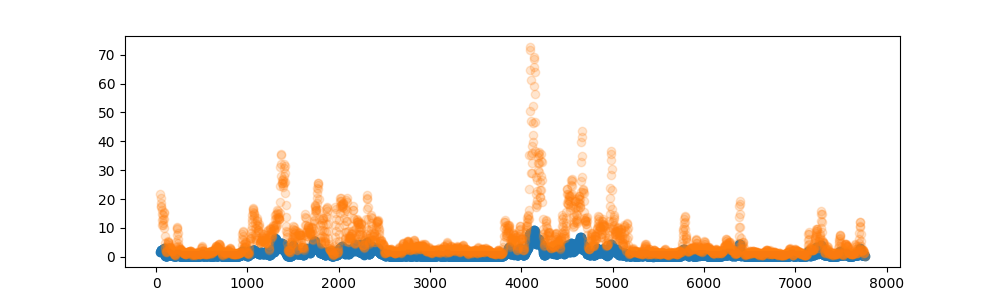

Head
d: 1


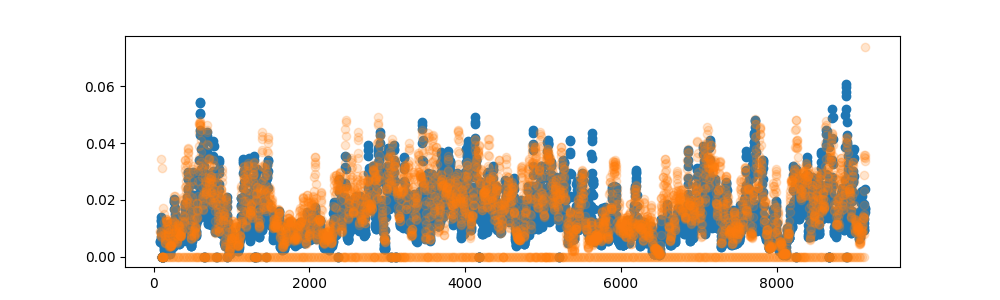

Head
d: 2


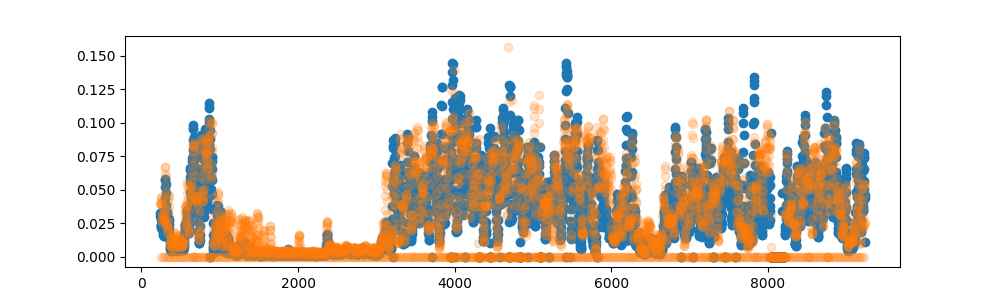

Head
d: 3


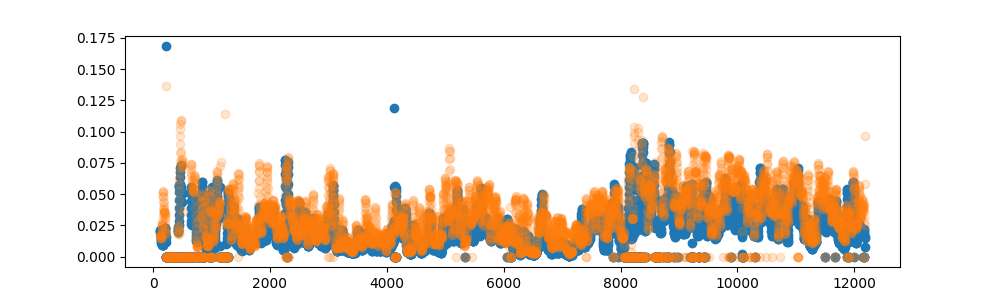

Head
d: 4


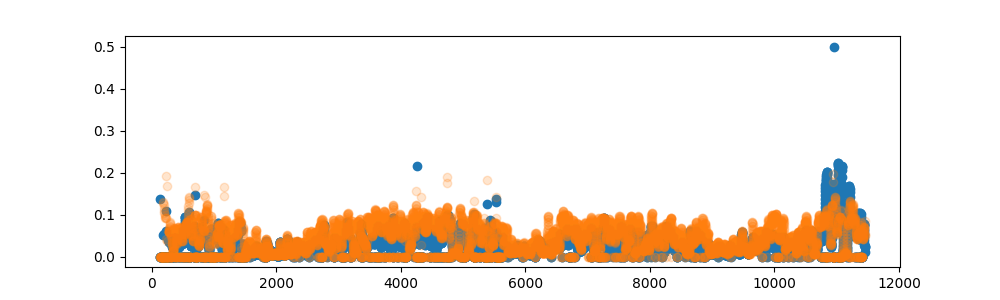

Head
d: 5


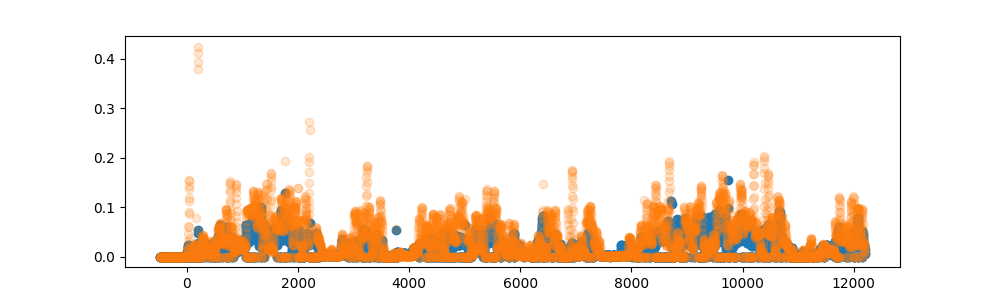

Head
d: 6


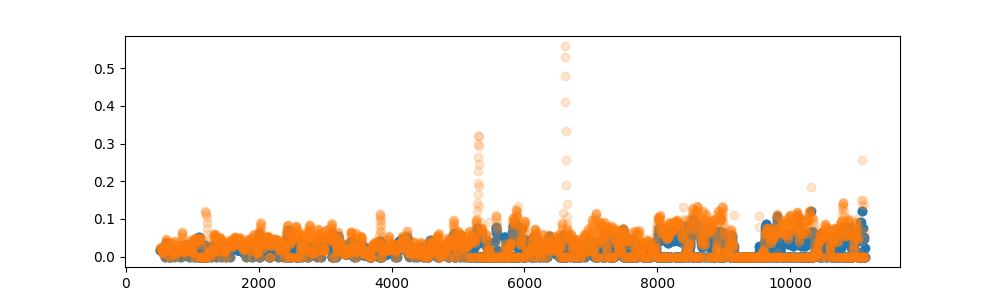

Head
d: 7


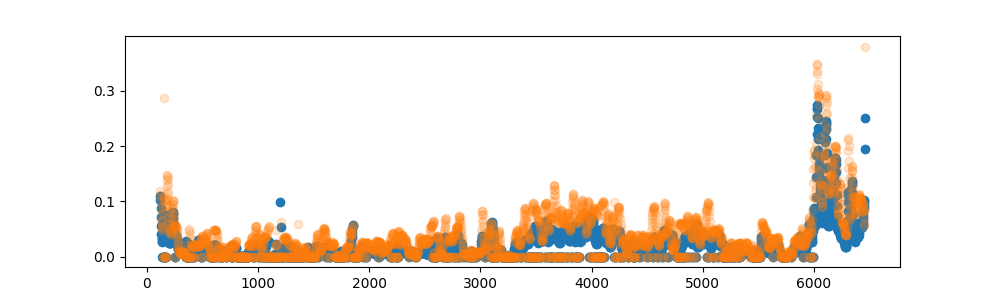

Head


In [16]:
#Define velocity threshold for forward and backward movement
#plot velocity of head
forward_vec= np.zeros((numW,8100))
Dorsal_vec = np.zeros((numW,8100))
ventral_vec = np.zeros((numW,8100))
backward_vec= np.zeros((numW,8100))
speed_vec= np.zeros((numW,8100))
turn_vec= np.zeros((numW,8100))
#%matplotlib widget

pix = [1, 0.001923, 0.002, 0.001923, 0.001923, 0.002222, 0.00196, 0.00185]
velchoice=16
thresh_bin0 = [0.06,6,6,12,10,12,12,12]
thresh_bin = [pix[w]*thresh_bin0[w] for w in range(numW)]
threshPos0 = [0.1,2.6,2,2.4,4.5,1.5,2,1]#[0.6,3.6,8.5,6.3,9.3,5.3]#based  on top 30 or 40percent percentile of V16
threshPos = [pix[w]*threshPos0[w] for w in range(numW)]
threshNeg0 =[-0.1,-1.6,-0.3,-1,-0.7,-0.5,-1.5,-1]#[-0.06,-2.6,-2.3,-2.5,-3.1,-2.9]#based on 30 percent of V16
threshNeg = [pix[w]*threshNeg0[w] for w in range(numW)]
speedthresh0 = [1,6,16,11,16,10,10,10]
speedthresh = [pix[w]*speedthresh0[w] for w in range(numW)]
head_thresh0 = [7,13,30,23,36,29,25,25]#based on 0.25 top percentie of velocity 25
head_thresh = [pix[w]*head_thresh0[w] for w in range(numW)]
for d in range(numW):
    print("d: "+str(d))
    rowsArr_float = copy.deepcopy(MegaData[d,:L[d],:])
    Vel5 = rowsArr_float[:,velchoice]
    Vel5sm = Bin.smooth_vec(rowsArr_float[:,velchoice])#dropbottom5perc(droptop5perc(rowsArr_float[:,velchoice],thresh=0.005),thresh=0.005)
    VelH = rowsArr_float[:,22]#dropbottom5perc(droptop5perc(rowsArr_float[:,22],thresh=0.01),thresh=0.01)
    fig = plt.figure(figsize=(10,3))
    ax = fig.add_subplot()
    VelMag = rowsArr_float[:,15]
    VelH_mag = rowsArr_float[:,25]
    ax.scatter(rowsArr_float[:,11],rowsArr_float[:,15])
    ax.scatter(rowsArr_float[:,11],VelH_mag,alpha=0.2 )

    plt.show()

    thet = rowsArr_float[:,46]#mid body angular velocity
    print("Head")
    forward_vec[d,:L[d]] = Vel5 > threshPos[d]
    backward_vec[d,:L[d]] = Vel5 < threshNeg[d]
    speed_vec[d,:L[d]] = VelMag > speedthresh[d]
    turn_vec[d,:L[d]]  = thet > 10 #moments where the worm takes a turn
    Dorsal_vec = VelH < - head_thresh[d]
    ventral_vec = VelH > head_thresh[d]

In [18]:
# define bins of different variables. and number of bins for each recording
m=1
max_neurons=13
neurons = [0,1,2,3,4,5,6,7,8,27,28,39,40]
thresh_bin = [0.6,6,6,12,10,12,12]
bin_coeff = [0.5,1,2,3,4,5,6,12,30]
y_labels = ['120','60', '30', '20', '15', '12', '10', '5','2']


In [19]:
importlib.reload(Bin)
importlib.reload(AllF)


<module 'Functions.AllFunctions' from '/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster/Functions/AllFunctions.py'>

# Compute Sliding Correlations

In [17]:
vchoice = 16
w0=300
d=0
print(d)
V10,V20 = AllF.compute_row_correlation_sliding(MegaData[d,:L[d],:],MegaData[d,:L[d],:], vchoice, [0,1,2,4],w=w0,scaleZscore=True)
d=1
print(d)
V11,V21 = AllF.compute_row_correlation_sliding(MegaData[d,:L[d],:],MegaData[d,:L[d],:], vchoice, [0,1,2,3,4,5],w=w0,scaleZscore=True)
d=2
print(d)
V12,V22 = AllF.compute_row_correlation_sliding(MegaData[d,:L[d],:],MegaData[d,:L[d],:], vchoice, [0,1,2,3,4,5],w=w0,scaleZscore=True)
d=3
print(d)
V13,V23 = AllF.compute_row_correlation_sliding(MegaData[d,:L[d],:], MegaData[d,:L[d],:],vchoice, [0,1,2,3,4,5],w=2*w0,scaleZscore=True)
d=4
print(d)
V14,V25 = AllF.compute_row_correlation_sliding(MegaData[d,:L[d],:],MegaData[d,:L[d],:],vchoice, [0,1,2,3,4,5],w=2*w0,scaleZscore=True)
d=5
print(d)
V15,V25 = AllF.compute_row_correlation_sliding(MegaData[d,:L[d],:], MegaData[d,:L[d],:],vchoice, [0,1,2,3,4,5],w=2*w0,scaleZscore=True)

d=6
print(d)
V16,V26 = AllF.compute_row_correlation_sliding(MegaData[d,:L[d],:], MegaData[d,:L[d],:],vchoice, [0,1,2,3,4,5],w=2*w0,scaleZscore=True)

0
1
2
3
4
5
6


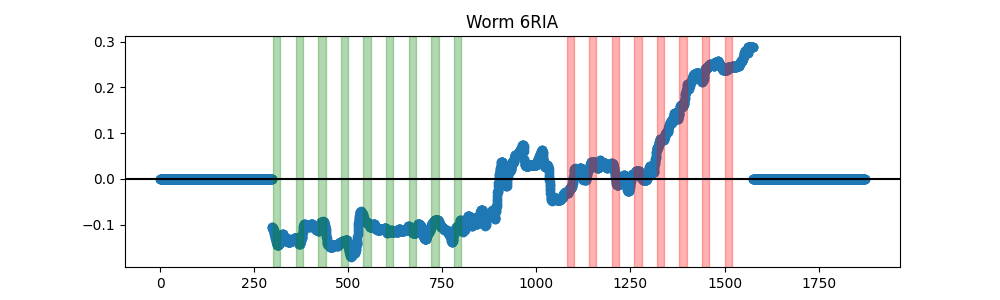

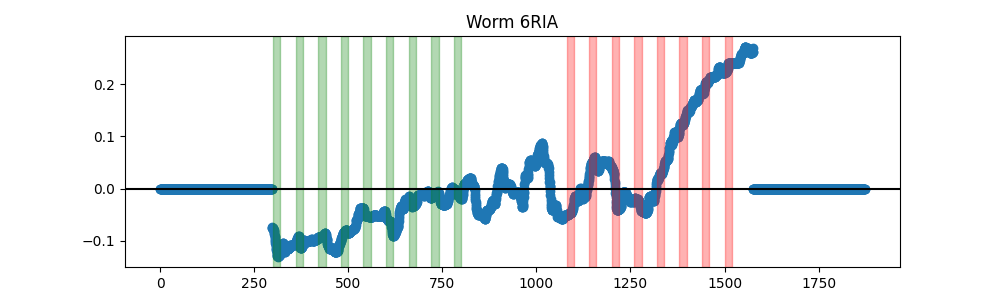

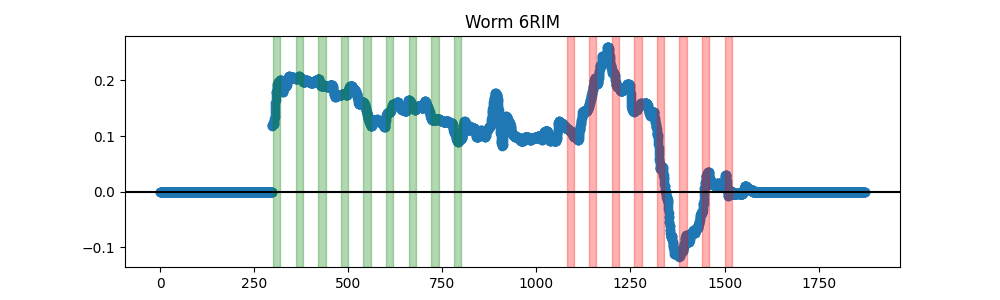

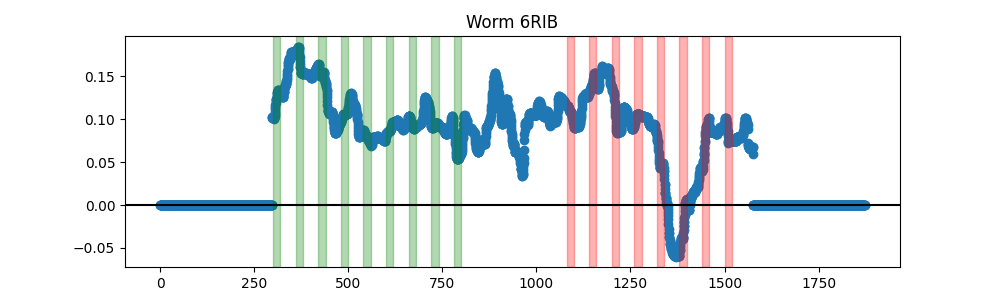

In [67]:
n_tit0 = ["RIA","RIA","RIM","RIB"]
d=6
st=0
timfr=12
#fig = plt.figure(figsize=(10,3))
for n in range(4):
    fig = plt.figure(figsize=(10,3))
    ax = fig.add_subplot()
    end=L[d]
    rowsArr_float = copy.deepcopy(MegaData[d,:L[d],:])
    ax.scatter(rowsArr_float[:,timfr],V16[n,:])    
    ax.set_title('Worm ' + str(d)+n_tit0[n])
    startIAA,EndIAA = AllF.get_nonzero_start_end(MegaData0[d,st:end,10]==1)
    start2NN,End2NN = AllF.get_nonzero_start_end(MegaData0[d,st:end,10]==2)
    for o in range(len(startIAA)):
        ax.axvspan(MegaData[d,startIAA[o],timfr],MegaData[d,EndIAA[o],timfr], color='green',alpha=0.3)
    for o in range(len(start2NN)):    
        ax.axvspan(MegaData[d,start2NN[o],timfr],MegaData[d,End2NN[o],timfr], color='red',alpha=0.3)
    ax.axhline(0, color='black')
    plt.show()


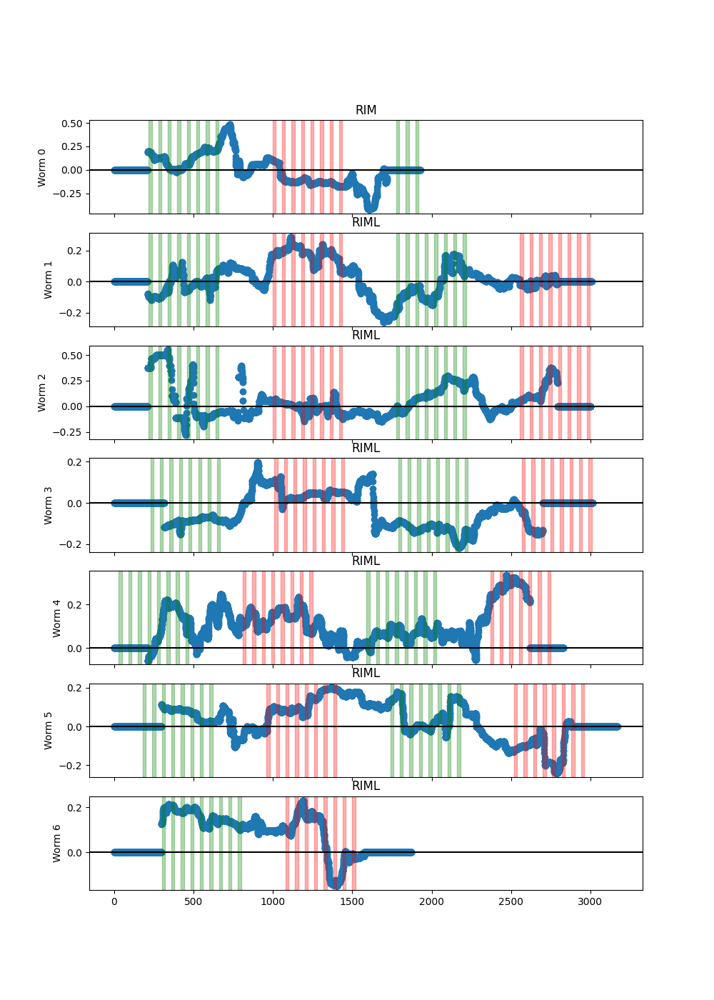

In [101]:
n_tit = ["RIAL","RIAR","RIML","RIMR","RIBL","RIBR"]
n=2
numWrm = 7
fig, axes = plt.subplots(numWrm, 1, figsize=(10, 2*numWrm), sharex=True)
for d in range(numWrm):
    ax = axes[d]
    rowsArr_float = copy.deepcopy(MegaData[d,:L[d],:])
    axes[d].set_title(n_tit[n])
    if d==0 and n<4 :
        ax.scatter(rowsArr_float[:,timfr],V10[n,:]) 
        axes[0].set_title(n_tit0[n])
    if d==1:
        ax.scatter(rowsArr_float[:,timfr],V11[n,:])
    if d==2:
        ax.scatter(rowsArr_float[:,timfr],V12[n,:])  
    if d==3:
        ax.scatter(rowsArr_float[:,timfr],V13[n,:])    
    if d==4:
        ax.scatter(rowsArr_float[:,timfr],V14[n,:])  
    if d==5:
        ax.scatter(rowsArr_float[:,timfr],V15[n,:])    

    if d==6:
        ax.scatter(rowsArr_float[:,timfr],V16[n,:]) 
    startIAA,EndIAA = AllF.get_nonzero_start_end(MegaData0[d,:L[d],10]==1)
    start2NN,End2NN = AllF.get_nonzero_start_end(MegaData0[d,:L[d],10]==2)
    for o in range(len(startIAA)):
        ax.axvspan(MegaData0[d,startIAA[o],timfr],MegaData0[d,EndIAA[o],timfr], color='green',alpha=0.3)
    for o in range(len(start2NN)):    
        ax.axvspan(MegaData0[d,start2NN[o],timfr],MegaData0[d,End2NN[o],timfr], color='red',alpha=0.3)
    ax.axhline(0, color='black')

    # Customize subplot
    
    ax.set_ylabel(f'Worm {d}')
    #ax.legend()

    # Add a common x-axis label
    #plt.xlabel('Value')
    #plt.tight_layout()
plt.show()

# correlation of different behaviors and interneurons activity
interneurons activities are normalized with `compute_vector_z_score(ActDeriv2s)*scale` with v=16 \
scale is `np.percentile(np.abs(V), 95)` for velocity \
scale is one for forward and backward frequency \
forward/backward frequency is with windows of size 10-20: `AllF.convert_states2Freq(forward_vec[d,:L[d]],window_size[d])` \
forward-backward velocity is computed as `V[backward_vec[d,:L[d]]>0] = -V0[backward_vec[d,:L[d]]>0]` with `V` the `center_signed_medium` velocity\
I think the scale for forward and backward velocity is also `np.percentile(np.abs(V), 95)` or it is one


In [20]:
L0 = np.copy(L)
L = np.copy(L)
#L[6] = 5300

In [21]:
print(L[6])


5355


In [106]:
importlib.reload(AllF)
n_tit = ["RIAL","RIAR","RIML","RIMR","RIBL","RIBR","sensory"]
numWorms = 8
vchoice =16
window_size = [10,10,10,20,20,20,20,20]
Correlations_v16 = np.zeros((numWorms,len(n_tit)))
Correlations_deriv_v16 = np.zeros((numWorms,len(n_tit)))
Correlations_derivFu_v16 = np.zeros((numWorms,len(n_tit)))
Correlations_deriv2s_v16 = np.zeros((numWorms,len(n_tit)))
Correlations_deriv2_v16 = np.zeros((numWorms,len(n_tit)))
Data = copy.deepcopy(MegaData)

for d in range(numWorms):
    st=0
    end=L[d]
    #V= AllF.convert_states2Freq(forward_vec[d,:L[d]],window_size[d])#3
    #V= AllF.convert_states2Freq(backward_vec[d,:L[d]],window_size[d])#4
    V0 = copy.deepcopy(MegaData[d,st:L[d],vchoice])#1,2
    #V = copy.deepcopy(Data[d,st:L[d],vchoice])#0,5
    V = np.zeros(np.shape((MegaData[d,st:L[d],vchoice])))#1,2,5
    #V[backward_vec[d,:L[d]]>0] = -V0[backward_vec[d,:L[d]]>0]#1
    V[forward_vec[d,:L[d]]>0] = V0[forward_vec[d,:L[d]]>0]#2
    #V[V>-1] = 0#
    scale = np.percentile(np.abs(V), 95)
    print(scale)
    print(L[d])
    for n in range(len(n_tit)):
        if d>0 or not(n in [3,5]):
            Act = (Data[d,st:L[d],n])
            ActDeriv = Deriv[d,st:L[d],n]
            ActDeriv2s = Deriv2s[d,st:L[d],n]
            ActDeriv2 = Deriv2[d,st:L[d],n]
            ActDerivFu = DerivFu[d,st:L[d],n]
            Correlations_v16[d,n],x = AllF.compute_2rows(AllF.compute_vector_z_score(Act)*scale,V)
            Correlations_deriv2s_v16[d,n],x = AllF.compute_2rows(AllF.compute_vector_z_score(ActDeriv2s)*scale,V)
            Correlations_deriv2_v16[d,n],x = AllF.compute_2rows(AllF.compute_vector_z_score(ActDeriv2)*scale,V)
            Correlations_deriv_v16[d,n],x = AllF.compute_2rows(AllF.compute_vector_z_score(ActDeriv)*scale,V)
            Correlations_derivFu_v16[d,n],x = AllF.compute_2rows(AllF.compute_vector_z_score(ActDerivFu)*scale,V)

1.8373352215778604
2756
0.02095639374474077
4297
0.062946040679304
4289
0.03398297263729686
5739
0.049454725540355064
8075
0.026812138507977576
6400
0.03881477988614688
5355
0.02305515433809226
3200


In [107]:
Corr_v16_all = np.zeros((5,numWorms,len(n_tit)))
Corr_v16_all[0,:,:] = Correlations_v16
Corr_v16_all[1,:,:] = Correlations_deriv2s_v16
Corr_v16_all[2,:,:] = Correlations_deriv2_v16
Corr_v16_all[3,:,:] = Correlations_deriv_v16
Corr_v16_all[4,:,:] = Correlations_derivFu_v16


In [108]:
Dictionary[vchoice]

'v_center_signed_medium'

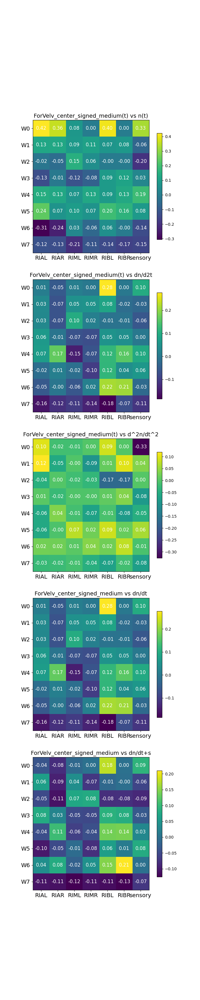

In [109]:
Set = 'ForVel'+ Dictionary[vchoice]
titles =  [Set + '(t) vs n(t)',Set + '(t) vs dn/d2t',Set + '(t) vs d^2n/dt^2',Set + ' vs dn/dt',Set + ' vs dn/dt+s']
fig, axes = plt.subplots(5,1, figsize=(7, 35))
matrices = Corr_v16_all
for i, ax in enumerate(axes):
    # Plot heatmap
    im = ax.imshow(matrices[i], cmap='viridis', aspect='equal')
    
    # Add values to the heatmap
    for row in range(matrices[i].shape[0]):
        for col in range(matrices[i].shape[1]):
            value = matrices[i][row, col]
            ax.text(col, row, f'{value:.2f}', ha='center', va='center', color='white', fontsize=12)

    # Customize subplot
    ax.set_title(titles[i], fontsize=14)
    ax.set_xticks(range(matrices[i].shape[1]))
    ax.set_yticks(range(matrices[i].shape[0]))
    ax.set_xticklabels(n_tit, fontsize=14)
    ax.set_yticklabels(['W0','W1','W2','W3','W4','W5','W6','W7'], fontsize=14)
    #ax.set_ylabel('window 10-20')

    # Add a colorbar
    fig.colorbar(im, ax=ax, location='right', shrink=0.8, pad=0.05)

#plt.tight_layout()
plt.show()

In [44]:
Corr_v16_max = np.zeros((5,numWorms,3))
for f in range(5):
    for w in range(numWorms):
        for k in range(3):
            ind_max = np.argmax(np.abs(Corr_v16_all[f,w,2*k:2*k+2]))
            Corr_v16_max[f,w,k] = Corr_v16_all[f,w,2*k+ind_max]
    

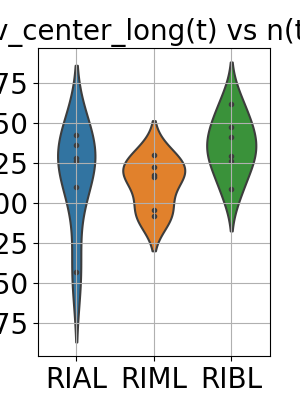

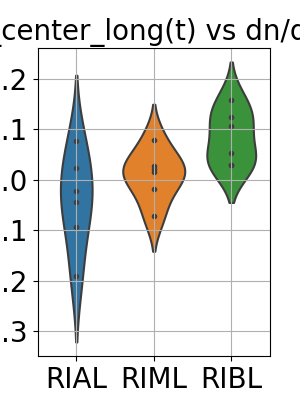

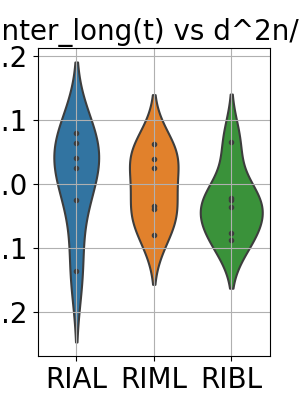

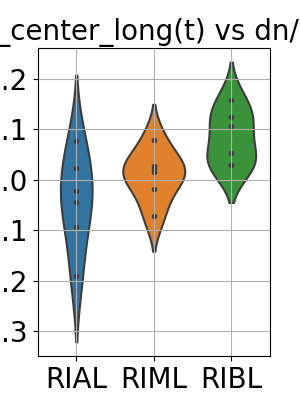

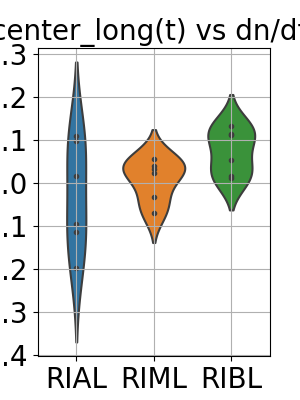

In [45]:
importlib.reload(Aut)

titles =  [Set + '(t) vs n(t)',Set+'(t) vs dn/d2t',Set+'(t) vs d^2n/dt^2',Set+'(t) vs dn/dt',Set+'(t) vs dn/dt+s']
worms_to_select = [0,1,3,4,5,6] 
matrices = Corr_v16_max
for i in range(5):
    Mat = matrices[i]
    fig = Aut.plot_parameters_violin(Mat[worms_to_select,:],n_tit[::2], paramName=titles[i],fs = 20)

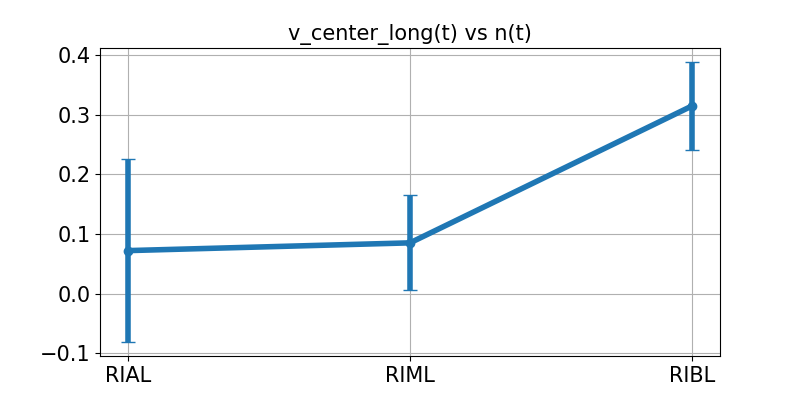

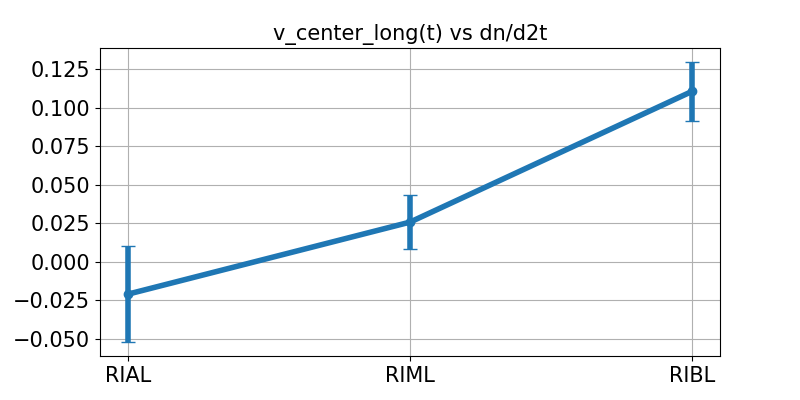

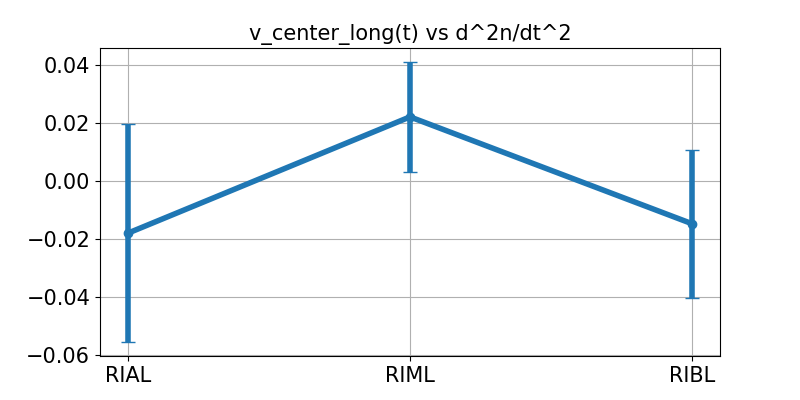

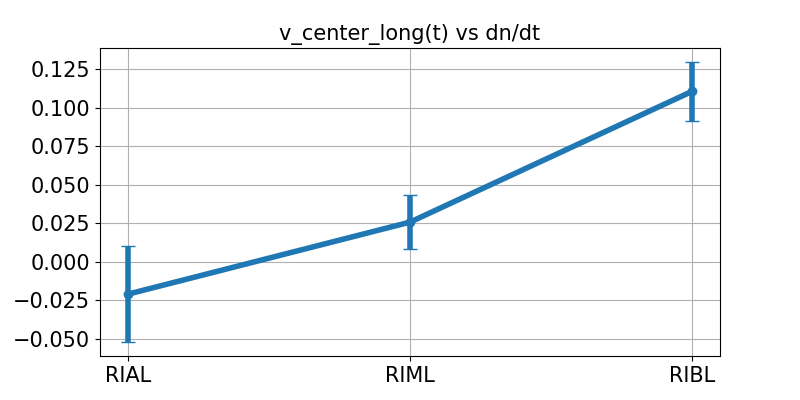

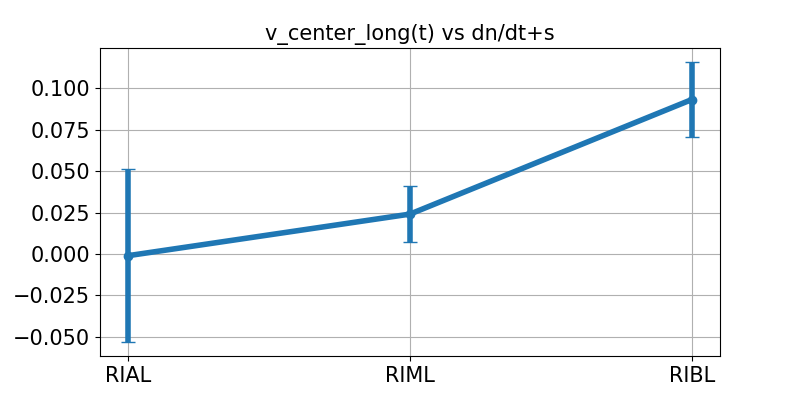

In [46]:
%matplotlib widget
importlib.reload(Aut)
#Set = 'Speed4w'
titles =  [Set + '(t) vs n(t)',Set+'(t) vs dn/d2t',Set+'(t) vs d^2n/dt^2',Set+'(t) vs dn/dt',Set+'(t) vs dn/dt+s']
worms_to_select = [3,4,5,6] 
matrices = Corr_v16_max
for i in range(5):
    Mat = matrices[i]
    Aut.plot_parameters_errbar(Mat[worms_to_select,:],n_tit[::2], paramName=titles[i],fs = 15)

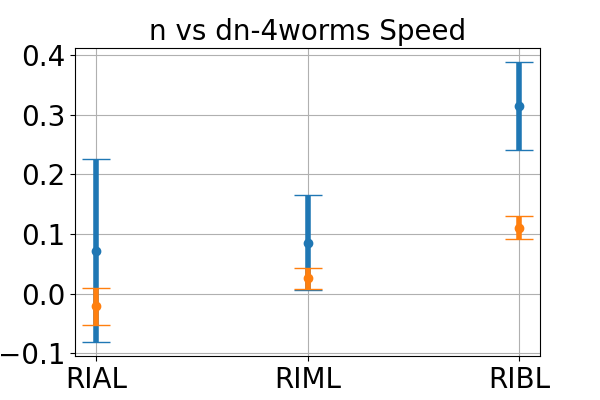

In [47]:
importlib.reload(Aut)
fig = Aut.plot_parameters_errbar2(Corr_v16_max[0,worms_to_select,:],Corr_v16_max[3,worms_to_select,:],n_tit[::2]
                            , paramName= 'n vs dn-4worms Speed',
                            fs = 20)

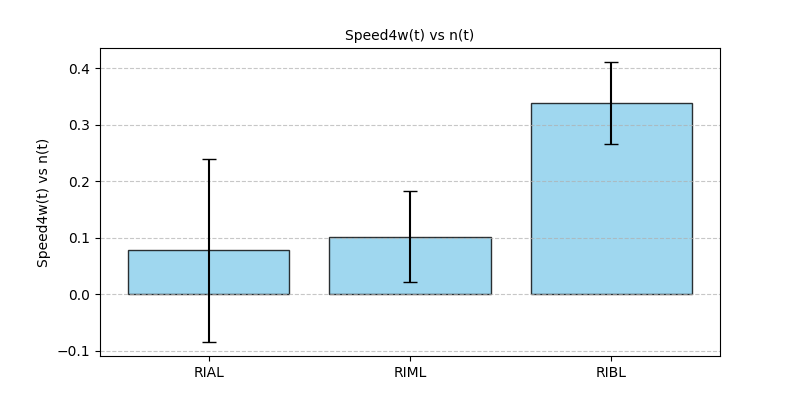

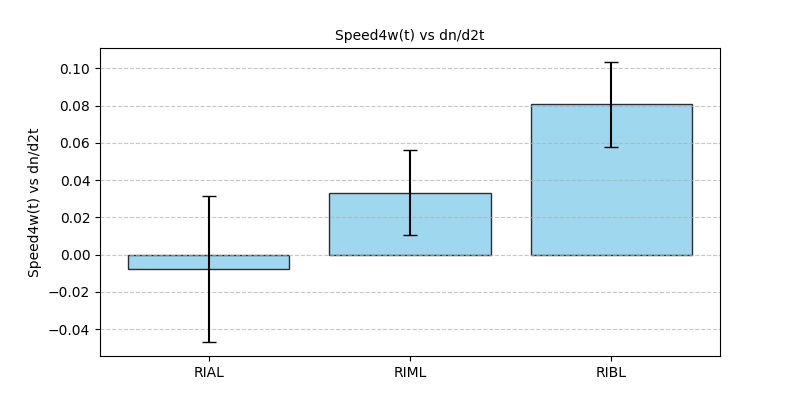

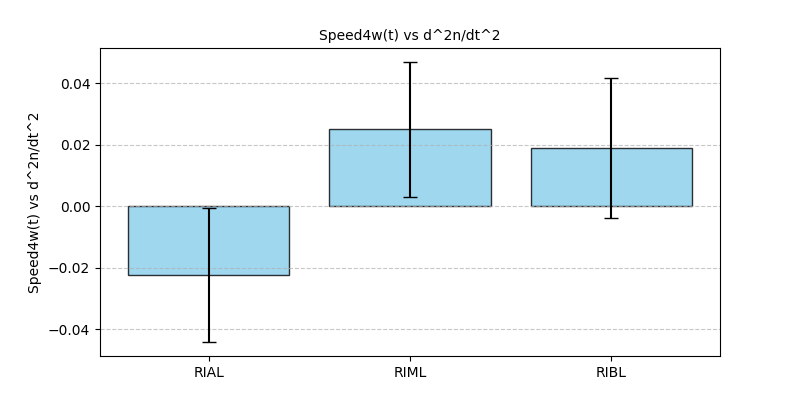

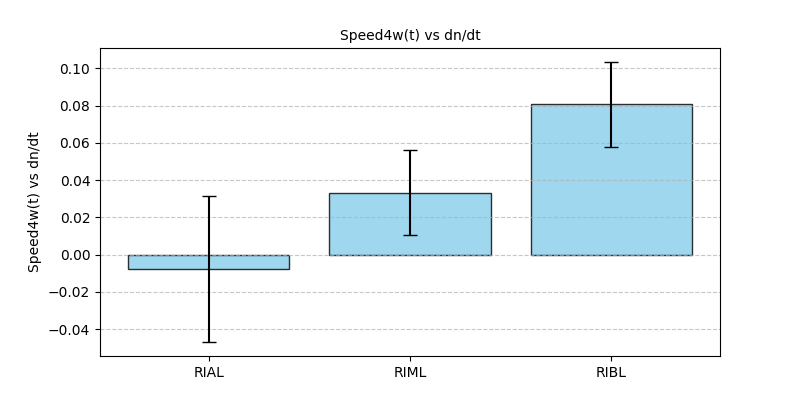

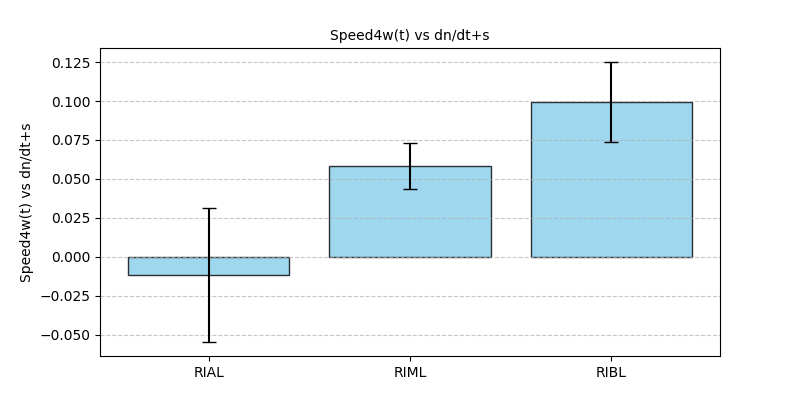

In [45]:
for i in range(5):
    Mat = matrices[i]
    Aut.plot_parameters_bar(Mat[worms_to_select,:],n_tit[::2], paramName=titles[i],fs = 10)

# correlation of different behaviors and neurites activity

neurite activities are normalized with compute_vector_z_score(ActDeriv2s)*scale \
scale is np.percentile(np.abs(V), 95) for velocity \
scale is one for forward and backward frequency \
forward/backward frequency is with windows of size 10-20: AllF.convert_states2Freq(forward_vec[d,:L[d]],window_size[d])\
forward-backward velocity is computed as V[backward_vec[d,:L[d]]>0] = -V0[backward_vec[d,:L[d]]>0] with V the center_signed_medium velocity\
The scale for forward and backward velocity is also np.percentile(np.abs(V_forward), 95)

head angle is computed through V = AllF.cross_product_vector(MegaData[d,st:end,49:51], x0) or V = AllF.cross_product_vector_angle(MegaData[d,st:end,49:51], x0) for these I used scale=1 actuall for these and also HN angle the scale doesnt make much difference

In [51]:
importlib.reload(AllF)
n_tit = ["sensory","nrDL","loopL","nrDR","loopR","nrVL","nrVR"]
neu = [6,7,8,27,28,39,40]
numWorms = 8
vchoice =16
x0 = [0,1]
window_size = [10,10,10,20,20,20,20,20]
Correlations_v16 = np.zeros((numWorms,len(neu)))
Correlations_deriv_v16 = np.zeros((numWorms,len(neu)))
Correlations_derivFu_v16 = np.zeros((numWorms,len(neu)))
Correlations_deriv2s_v16 = np.zeros((numWorms,len(neu)))
Correlations_deriv2_v16 = np.zeros((numWorms,len(neu)))
for d in range(numWorms):
    print(d)
    st = 0#AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,2]))
    end = L[d]#AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,3]))#L[d]
    
    #V = AllF.cross_product_vector_angle(MegaData[d,st:end,51:53], x0)
    #V[sm[d]:] = V[sm[d]:]-V[:-sm[d]]
    V = copy.deepcopy(MegaData[d,st:end,vchoice])
    #V[:-2*sm[d]] = V[2*sm[d]:]
    #V[np.isnan(V)]=0
    #print(np.shape(V))
    #V = copy.deepcopy(MegaData[d,st:L[d],vchoice])
    #V= AllF.convert_states2Freq(backward_vec[d,:L[d]],window_size[d])
    #V0 = copy.deepcopy(MegaData[d,st:L[d],vchoice])
    #V = np.zeros(np.shape((MegaData[d,st:L[d],vchoice])))
    #V[forward_vec[d,:L[d]]>0] = V0[forward_vec[d,:L[d]]>0]
    scale = np.percentile(np.abs(V), 95)
    for n0 in range(len(neu)):
        n = neu[n0]
        if d>0 or not(n in [3,5]):
            Act = MegaData[d,st:end,n]
            ActDeriv = Deriv[d,st:end,n]
            ActDeriv2s = Deriv2s[d,st:end,n]
            ActDeriv2 = Deriv2[d,st:end,n]
            ActDerivFu = DerivFu[d,st:end,n]
            Correlations_v16[d,n0],x = AllF.compute_2rows(AllF.compute_vector_z_score(Act)*scale,V)
            Correlations_deriv2s_v16[d,n0],x = AllF.compute_2rows(AllF.compute_vector_z_score(ActDeriv2s)*scale,V)
            Correlations_deriv2_v16[d,n0],x = AllF.compute_2rows(AllF.compute_vector_z_score(ActDeriv2)*scale,V)
            Correlations_deriv_v16[d,n0],x = AllF.compute_2rows(AllF.compute_vector_z_score(ActDeriv)*scale,V)
            Correlations_derivFu_v16[d,n0],x = AllF.compute_2rows(AllF.compute_vector_z_score(ActDerivFu)*scale,V)

0
1
2
3
4
5
6
7
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data
no simultaneous data


In [52]:
x0 = [0,1]
print(x0[0])
print(x0[1])

0
1


In [53]:
Corr_v16_all_neu = np.zeros((5,numWorms,7))
Corr_v16_all_neu[0,:,:] = Correlations_v16
Corr_v16_all_neu[1,:,:] = Correlations_deriv2s_v16
Corr_v16_all_neu[2,:,:] = Correlations_deriv2_v16
Corr_v16_all_neu[3,:,:] = Correlations_deriv_v16
Corr_v16_all_neu[4,:,:] = Correlations_derivFu_v16

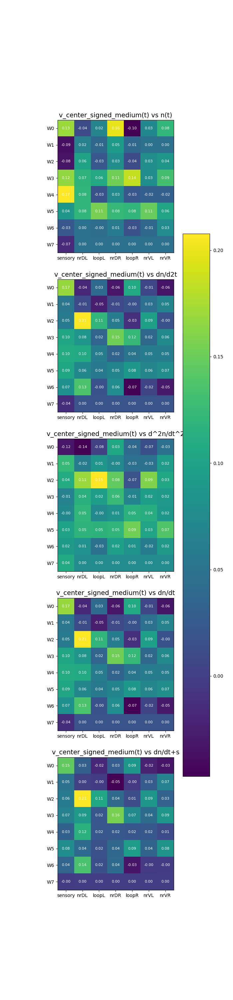

In [54]:
%matplotlib widget
Set = Set = Dictionary[vchoice]
titles =  [Set + '(t) vs n(t)',Set+'(t) vs dn/d2t',Set+'(t) vs d^2n/dt^2',Set+'(t) vs dn/dt',Set+'(t) vs dn/dt+s']
fig, axes = plt.subplots(5,1, figsize=(7, 30))
matrices = Corr_v16_all_neu
for i, ax in enumerate(axes):
    # Plot heatmap
    im = ax.imshow(matrices[i], cmap='viridis', aspect='equal')
    
    # Add values to the heatmap
    for row in range(matrices[i].shape[0]):
        for col in range(matrices[i].shape[1]):
            value = matrices[i][row, col]
            ax.text(col, row, f'{value:.2f}', ha='center', va='center', color='white', fontsize=8)

    # Customize subplot
    ax.set_title(titles[i], fontsize=14)
    ax.set_xticks(range(matrices[i].shape[1]))
    ax.set_yticks(range(matrices[i].shape[0]))
    ax.set_xticklabels(n_tit)
    ax.set_yticklabels(['W0','W1','W2','W3','W4','W5','W6','W7'])
    #ax.set_ylabel('window 10-20')

# Add a colorbar
fig.colorbar(im, ax=axes, location='right', shrink=0.8, pad=0.05)

#plt.tight_layout()
plt.show()

2109
2534
2109
2534
2109
2534
2810
3377
3643
4494
2900
3505
3148
3592
3148
3199


/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster/Functions/AllFunctions.py:403: RuntimeWarning: invalid value encountered in double_scalars
  out_v[t] = (Vec[t,0] * v[1] - Vec[t,1] * v[0])/np.linalg.norm(Vec[t,:])
/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster/Functions/AllFunctions.py:334: RuntimeWarning: Mean of empty slice
  mean = np.nanmean(vector[np.nonzero(vector)[0]])
/home/mahsa/anaconda3/envs/Targettrack/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


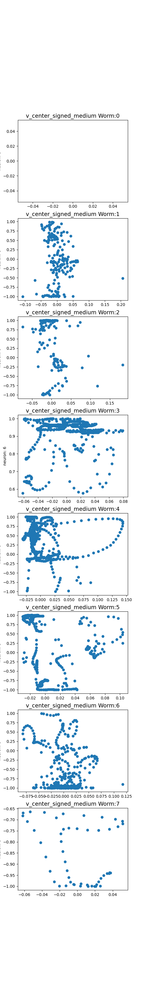

In [56]:
#titles =  ['HvectorIAA2(t) vs n(t)','HvectorBuffer2((t) vs dn/d2t','HvectorBuffer2((t) vs d^2n/dt^2','HvectorBuffer2((t) vs dn/dt','HvectorBuffer2((t) vs dn/dt+s']
fig, axes = plt.subplots(numWorms,1, figsize=(5, 35))
x0 = [0,1]
n=6
for d, ax in enumerate(axes):
    # Plot heatmap
    st = AllF.closest_index(MegaData0[d,:L[d],12], int(NN_int[d,1]))
    end = AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,2]))#L[d]
    print(st)
    print(end)
    V = AllF.cross_product_vector(MegaData[d,st:end,49:51], x0)
    Act = MegaData[d,st:end,n]
    time_intersection = (np.abs(V)>0)&(np.abs(Act)>0)
    ax.scatter(AllF.compute_vector_z_score(Act[time_intersection])*scale,V[time_intersection])
    
    # Customize subplot
    ax.set_title(Set + ' Worm:'+str(d), fontsize=14)
    
    ax.set_ylabel('angle')
    ax.set_ylabel('neuron: '+str(n))

#plt.tight_layout()
plt.show()

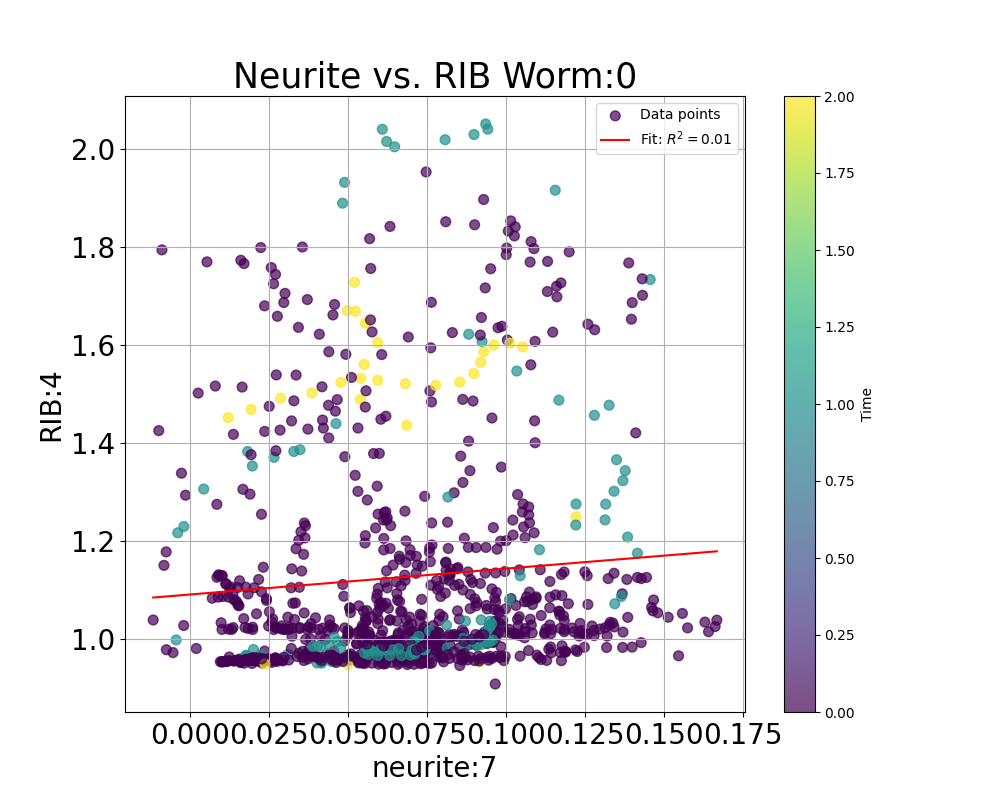

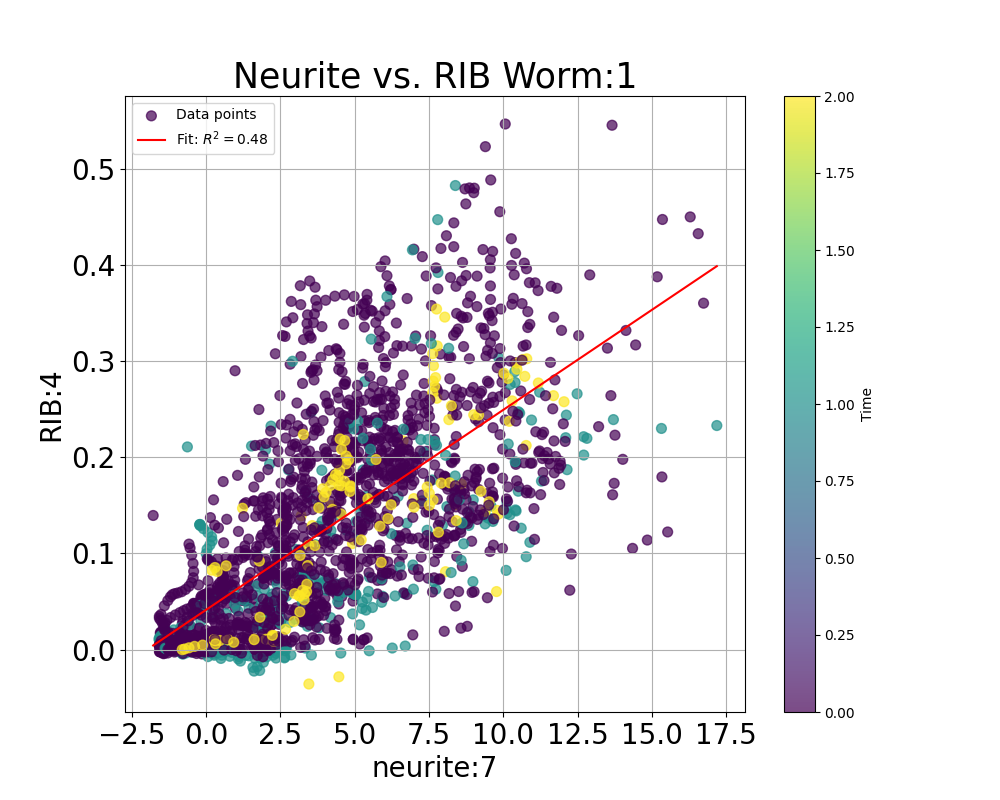

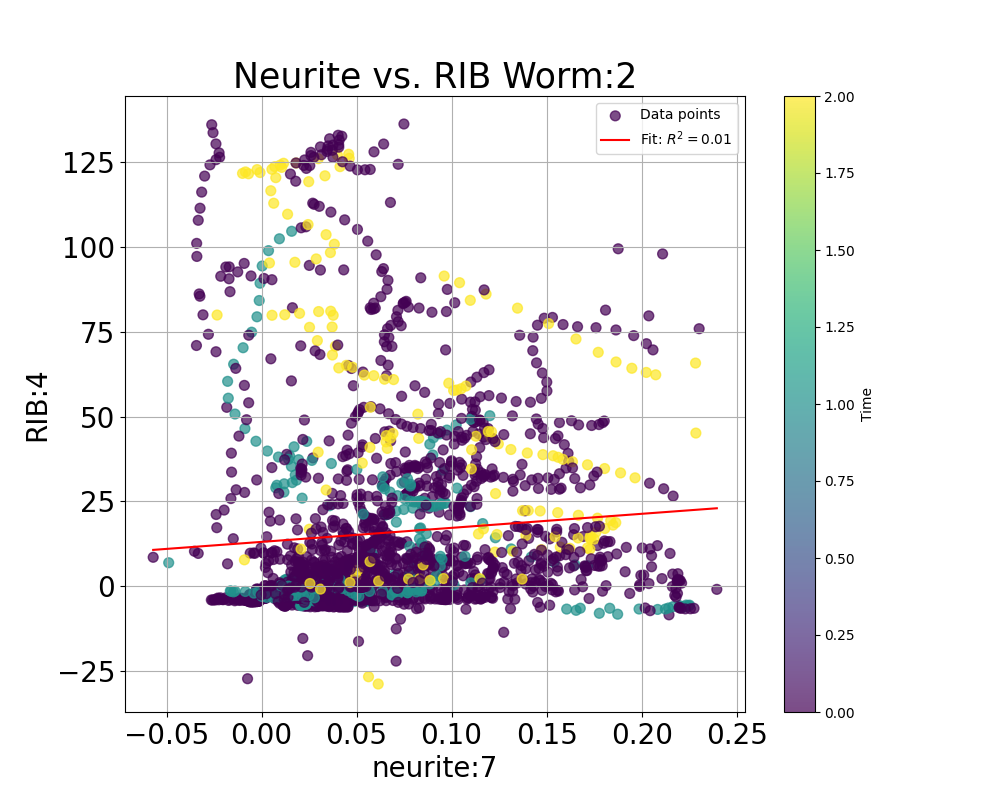

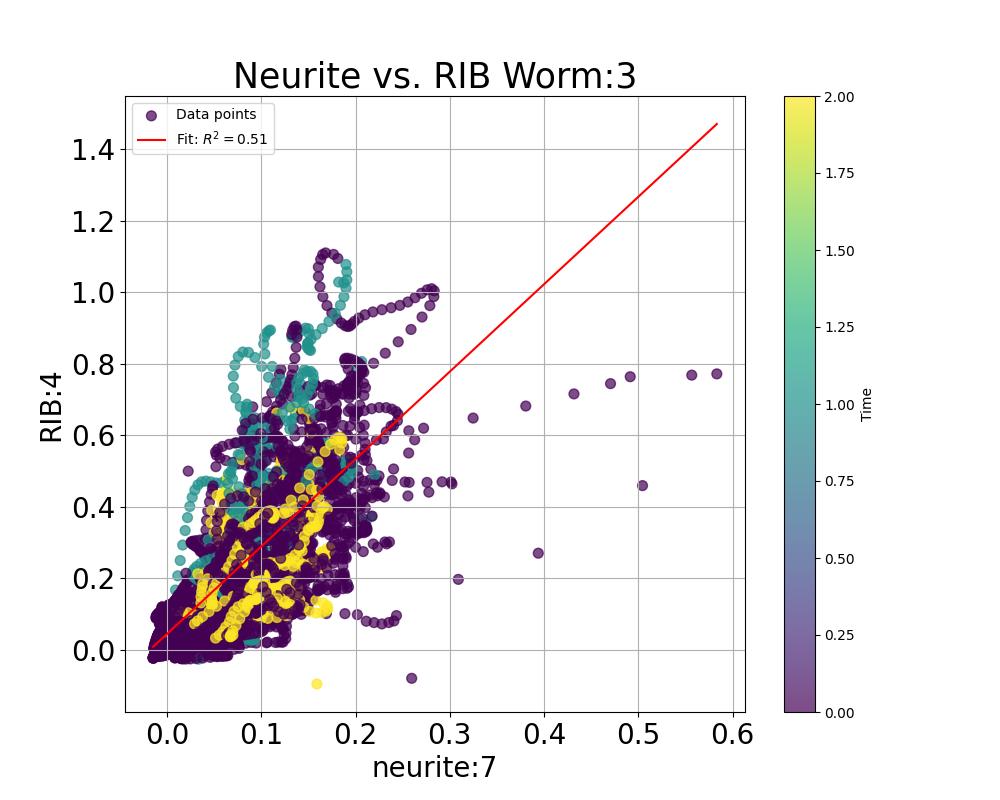

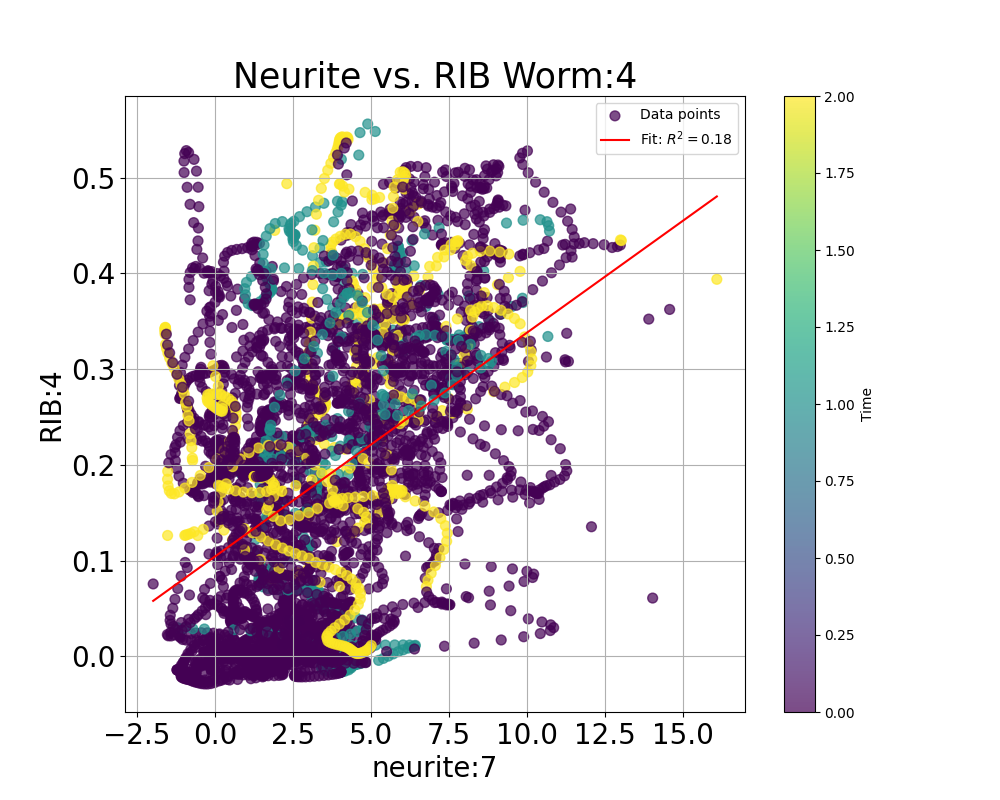

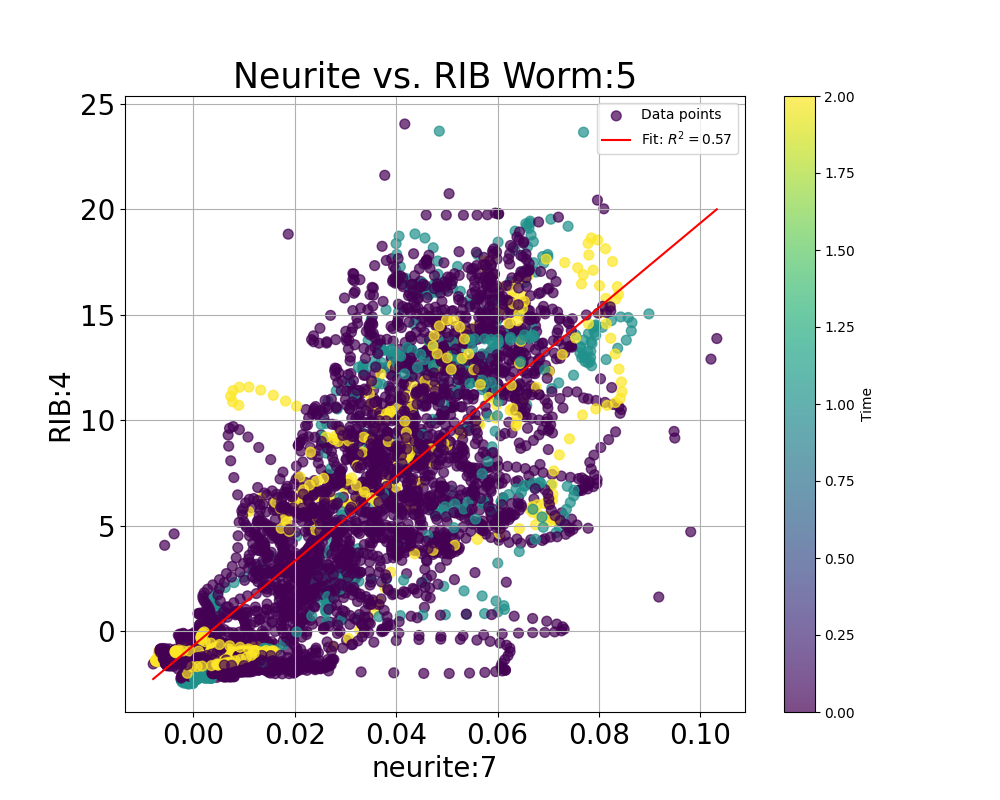

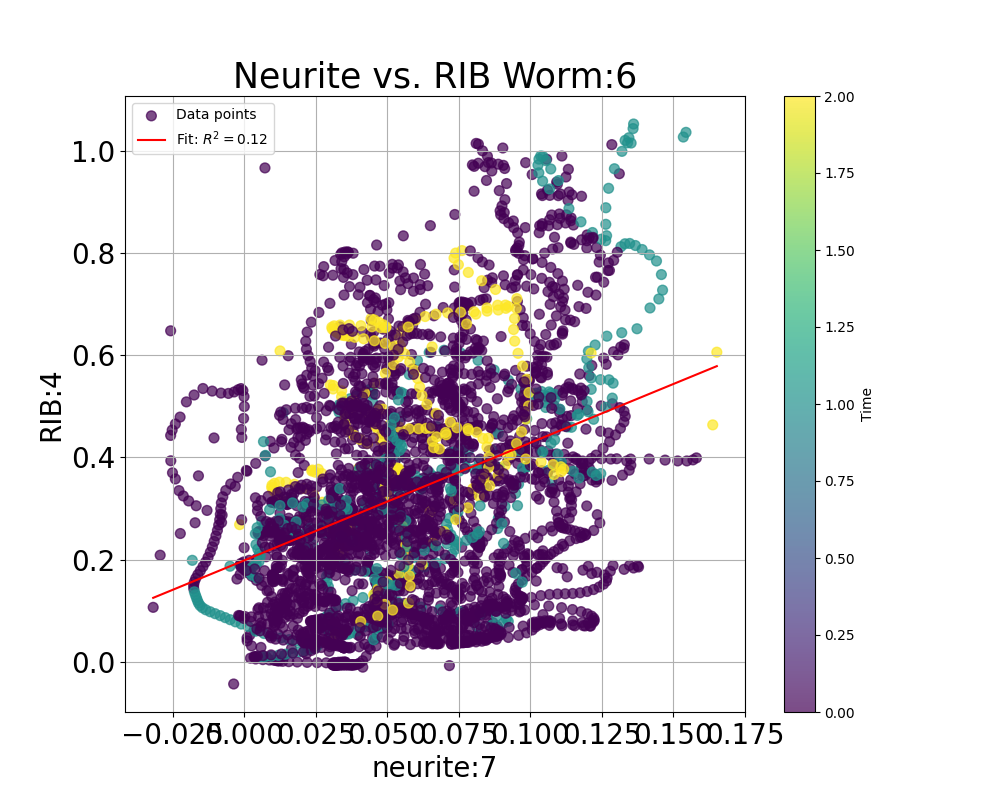

In [167]:
#titles =  ['HvectorBuffer2(t) vs n(t)','HvectorBuffer2((t) vs dn/d2t','HvectorBuffer2((t) vs d^2n/dt^2','HvectorBuffer2((t) vs dn/dt','HvectorBuffer2((t) vs dn/dt+s']
importlib.reload(AllF)
Set1 = "Neurite vs. RIB"#'RIMvsRIB-IAA2'
vchoice1 = 4
n=7
numW=7
for d in range(numW):
    st = 0#AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,2]))
    end = L[d]#AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,3]))#L[d]    
    #V = AllF.cross_product_vector_angle(MegaData[d,st:end,51:53], x0)
    #V[sm[d]:] = V[sm[d]:]-V[:-sm[d]]
    V = copy.deepcopy(MegaData[d,st:end,vchoice1])
    #V[:-sm[d]] = V[sm[d]:]
    #V = AllF.cross_product_vector_angle(MegaData[d,st:end,51:53], x0)
    #V = (Deriv[d,st:end,38])
    V[np.isinf(V)]=0
    #V[sm[d]:] = V[sm[d]:] - V[:-sm[d]]
    V[np.isnan(V)]=0
    Act = copy.deepcopy(MegaData[d,st:end,n])
    AllF.plot_scatter_with_fit(Act, V, MegaData0[d,st:end,10],xlab="neurite:"+str(n),ylab="RIB:"+str(vchoice1),titre= Set1 +' Worm:'+str(d))

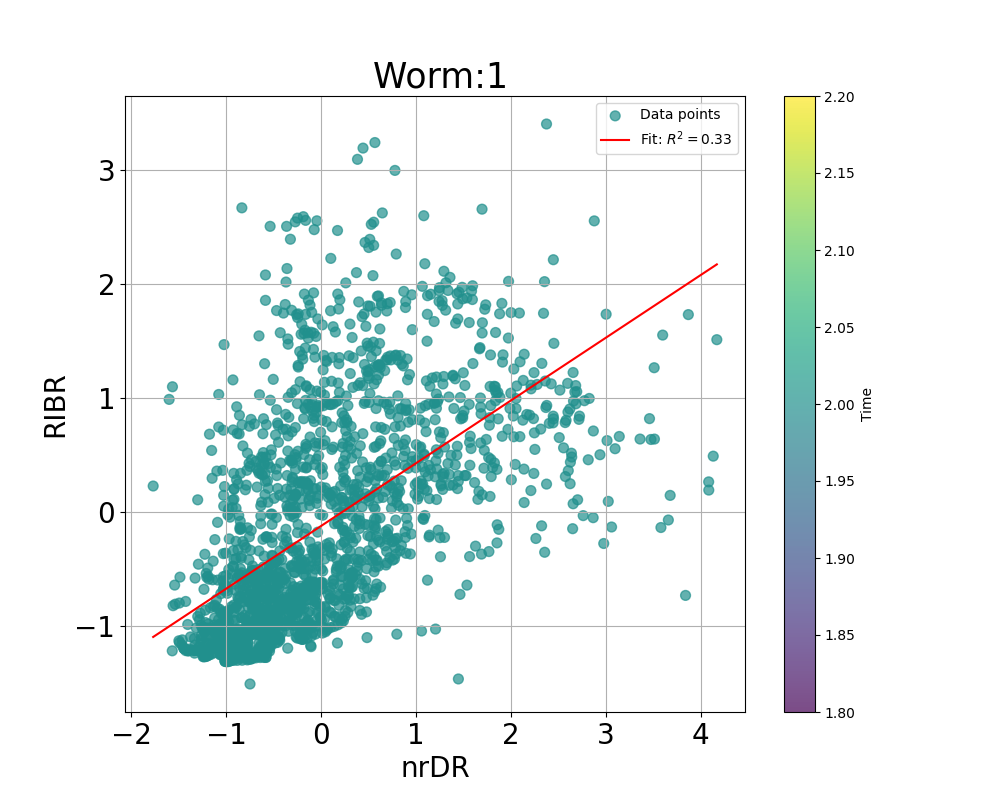

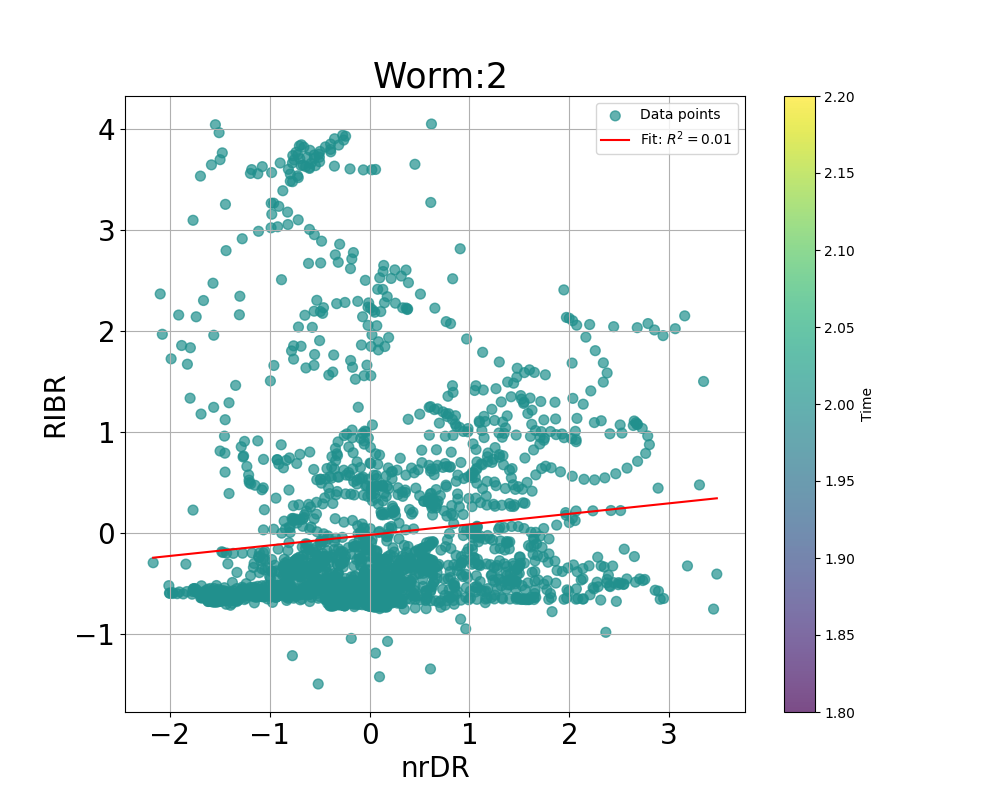

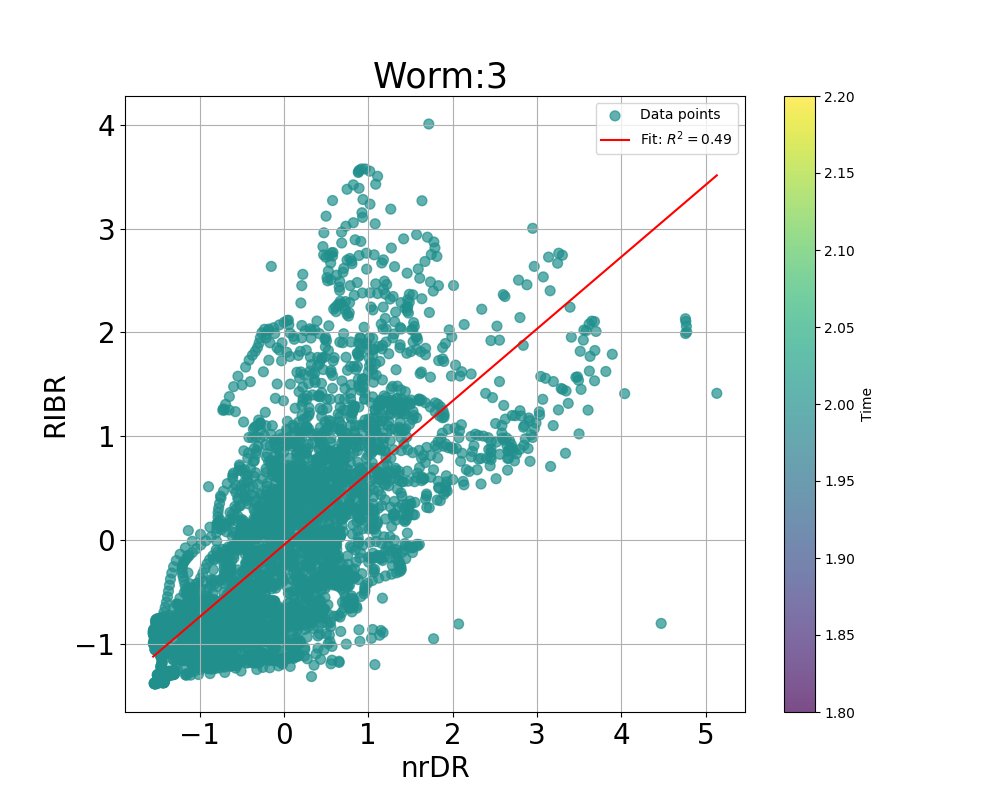

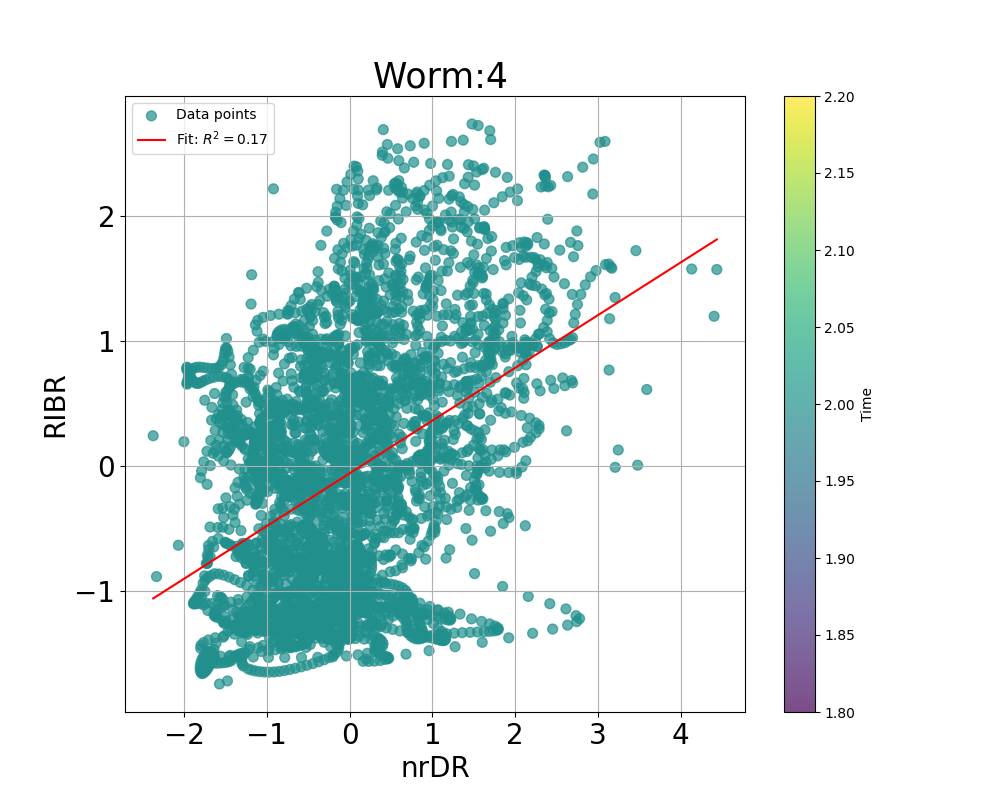

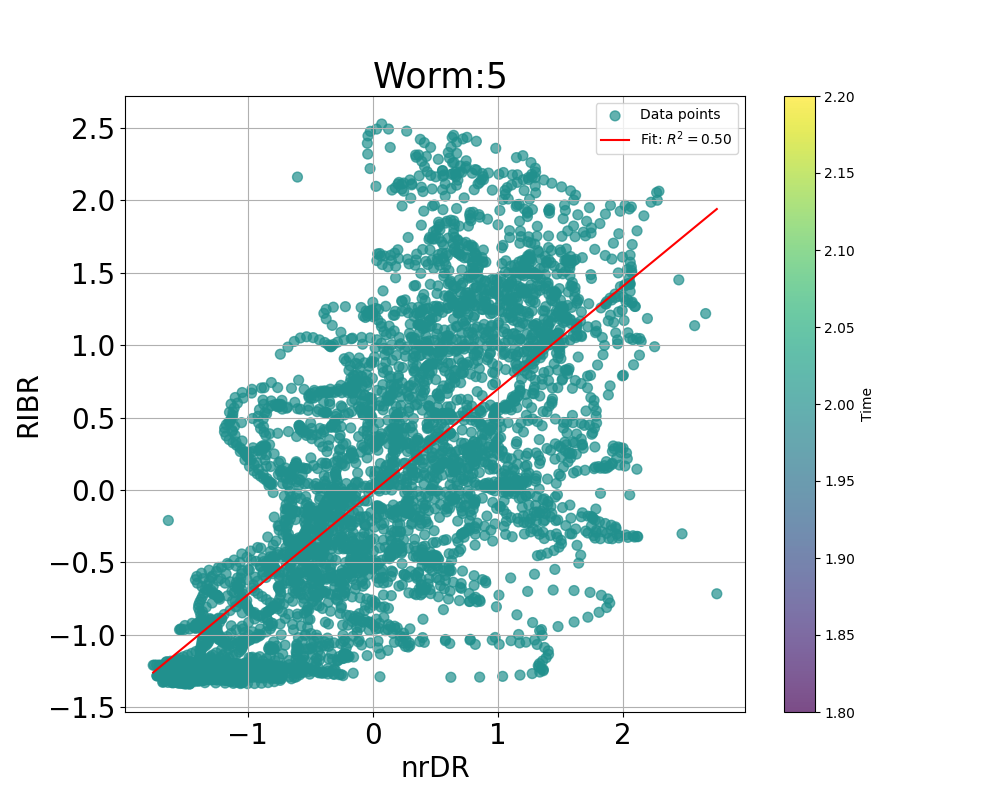

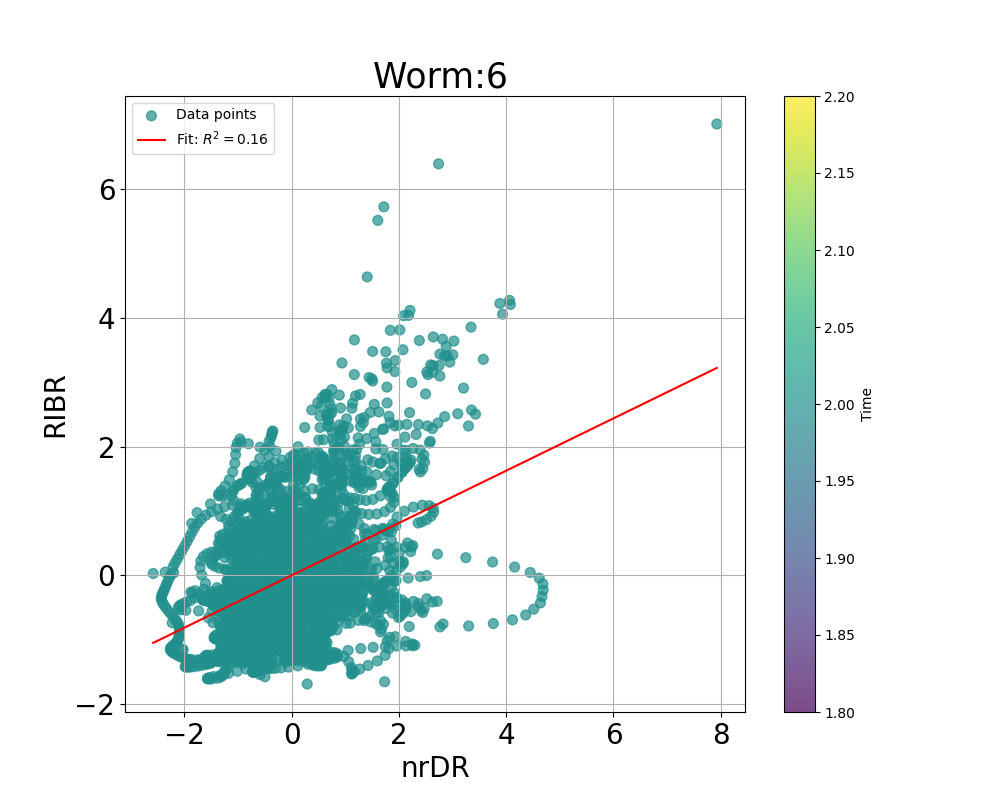

In [168]:

importlib.reload(AllF)
Set1 = "Neurite vs. RIB"#'RIMvsRIB-IAA2'
vchoice1 = 5
n=27
numW=7
for d in range(1,numW):
    st = 0
    end = L[d]
    V = AllF.compute_vector_z_score(copy.deepcopy(MegaData[d,st:end,vchoice1]))
    V[np.isinf(V)]=0
    V[np.isnan(V)]=0
    Act = AllF.compute_vector_z_score(copy.deepcopy(MegaData[d,st:end,n]))
    AllF.plot_scatter_with_fit(Act, V, 2*np.ones(len(V)),xlab="nrDR",ylab="RIBR",titre= ' Worm:'+str(d))

/mnt/DATA/Mahsa/movies/LongRecordings/codes/Cluster/Functions/AllFunctions.py:334: RuntimeWarning: Mean of empty slice
  mean = np.nanmean(vector[np.nonzero(vector)[0]])
/home/mahsa/anaconda3/envs/Targettrack/lib/python3.8/site-packages/numpy/lib/nanfunctions.py:1879: RuntimeWarning: Degrees of freedom <= 0 for slice.
  var = nanvar(a, axis=axis, dtype=dtype, out=out, ddof=ddof,


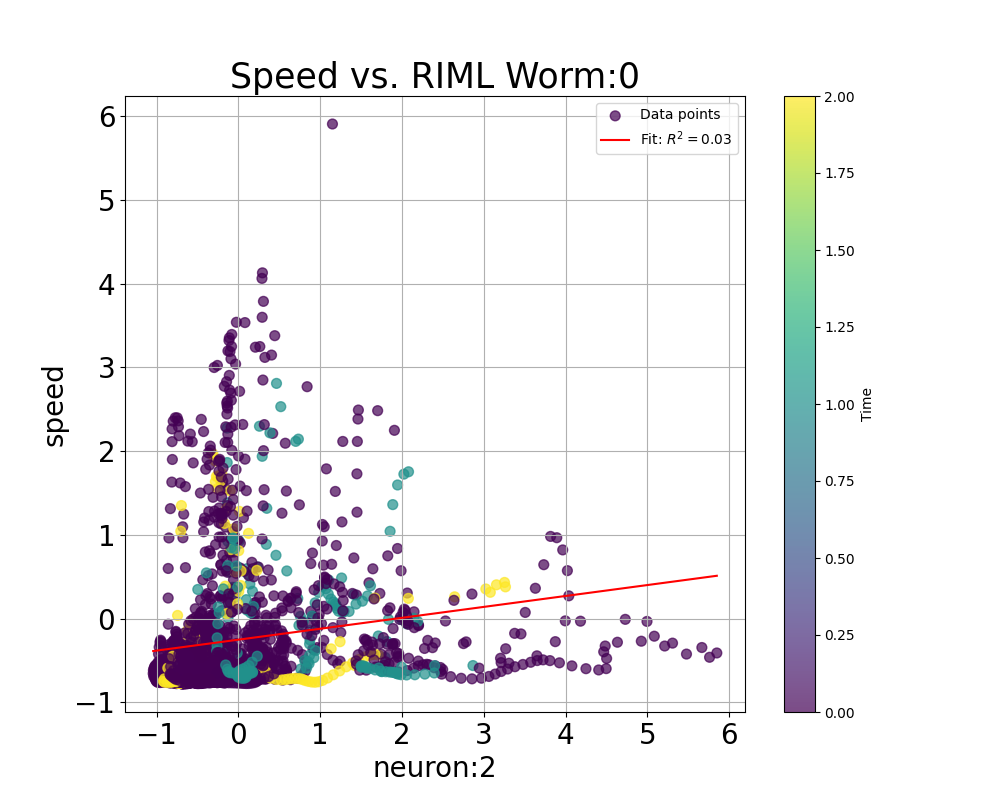

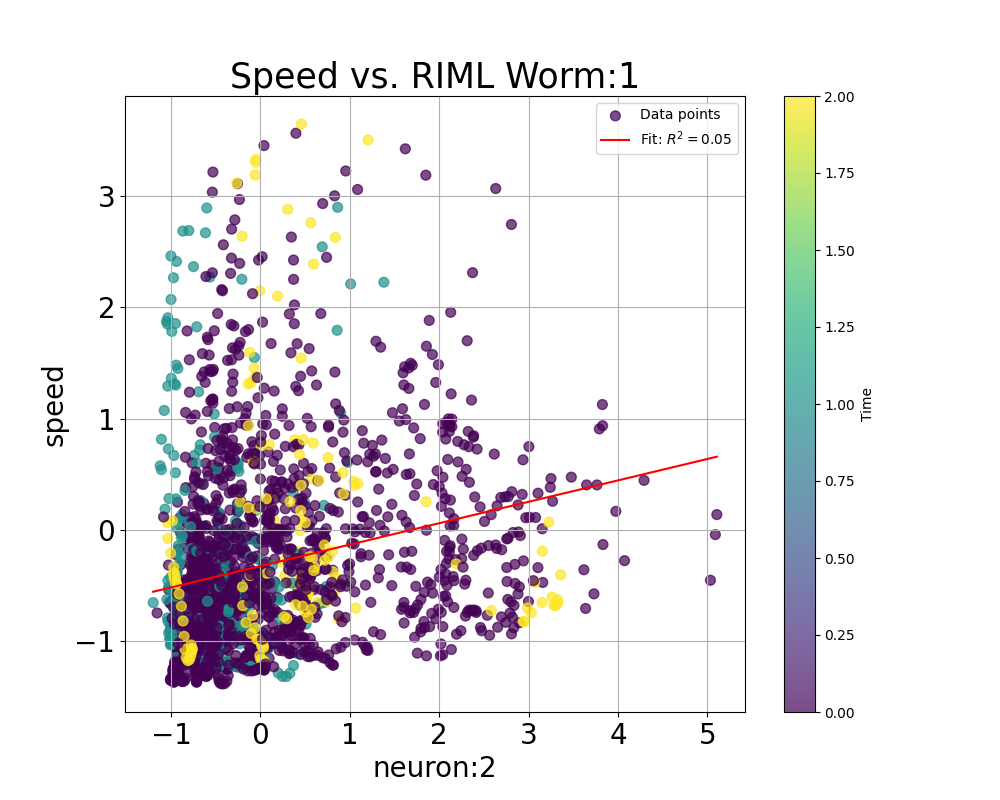

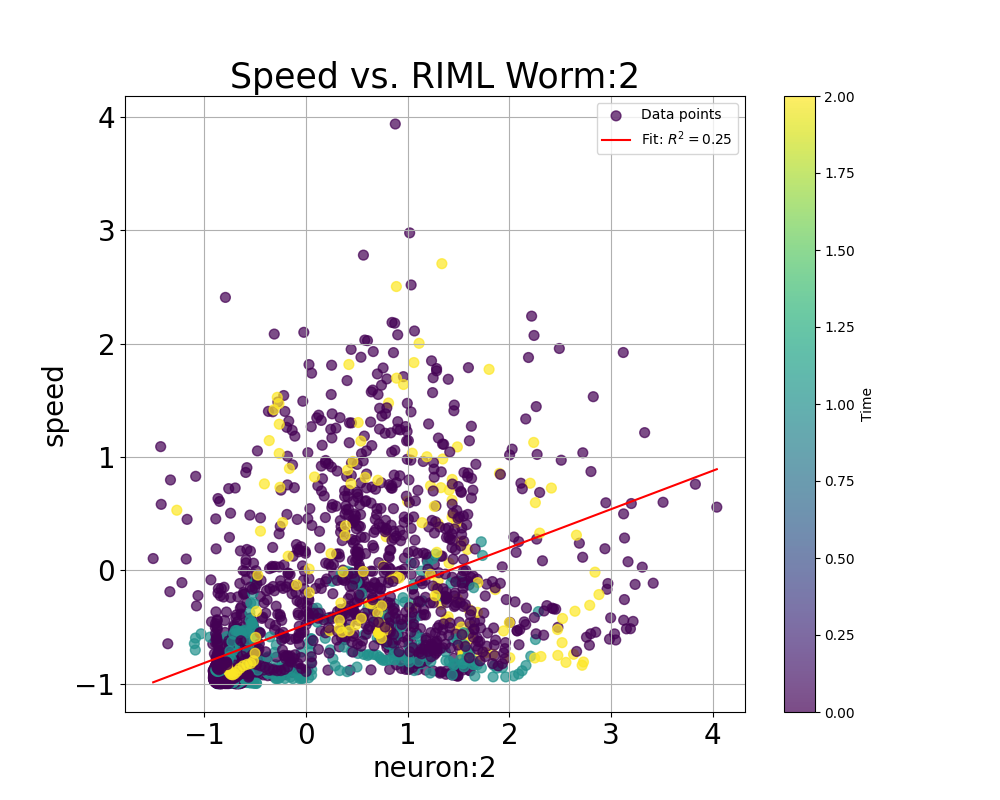

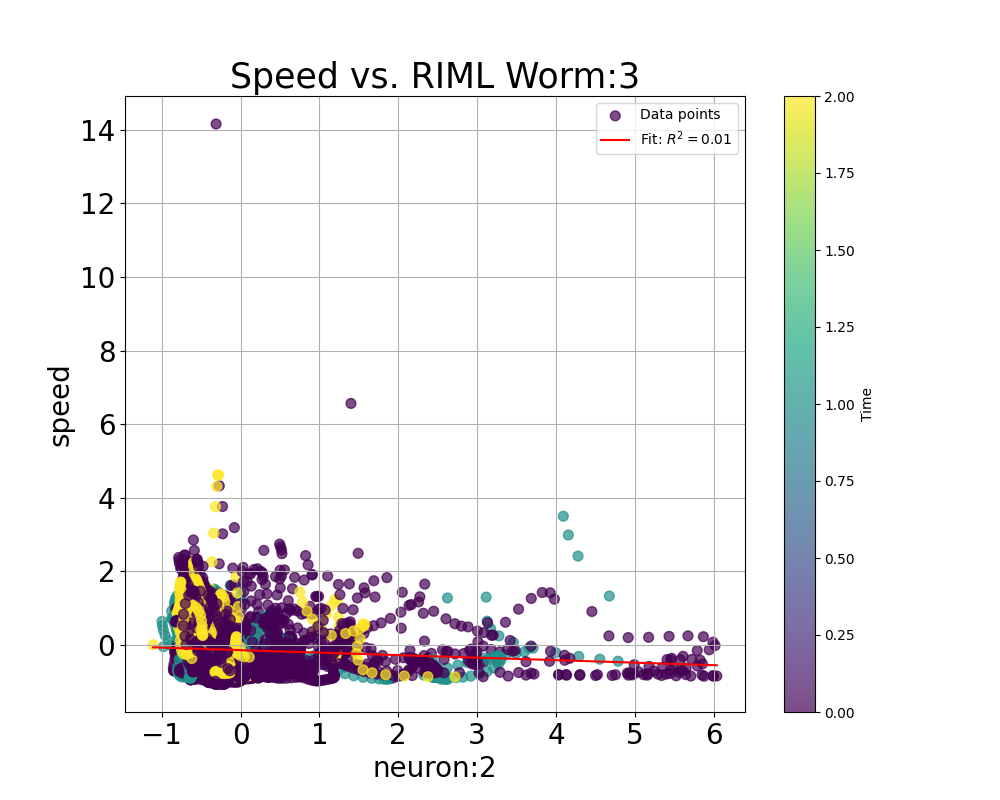

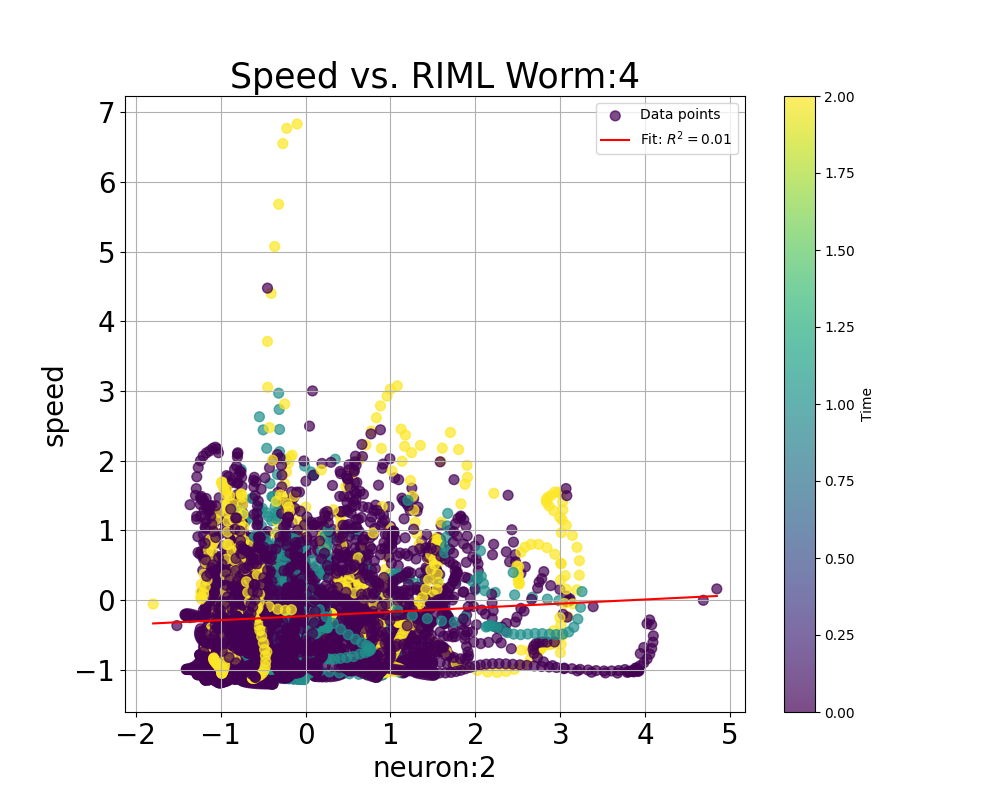

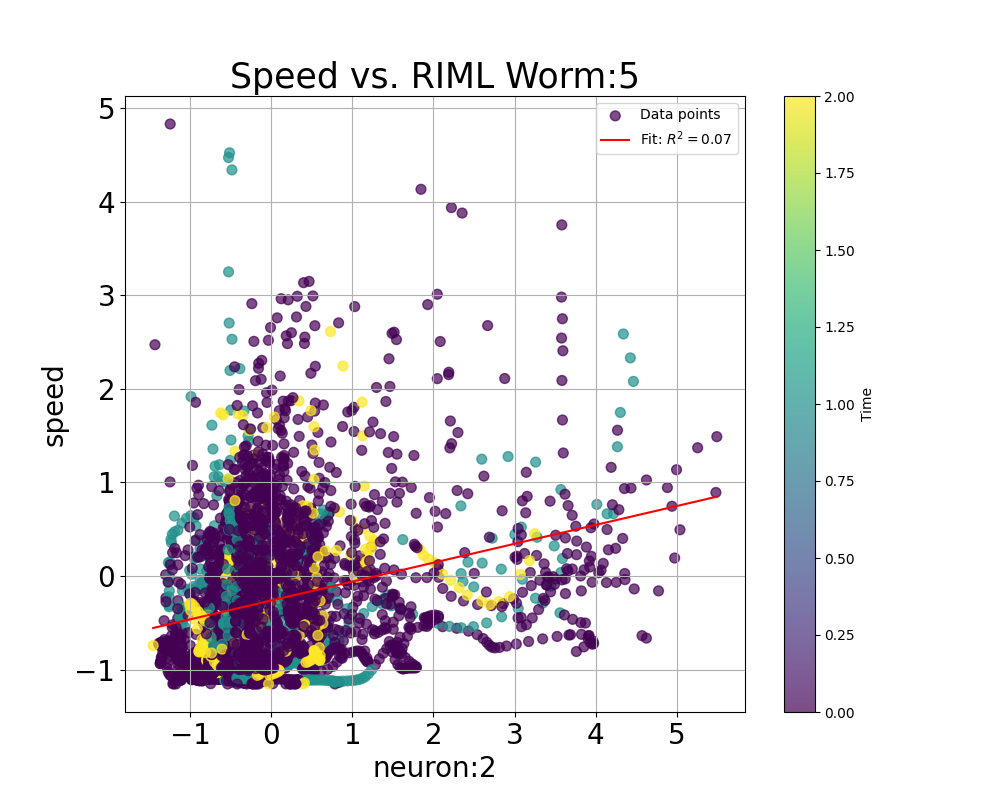

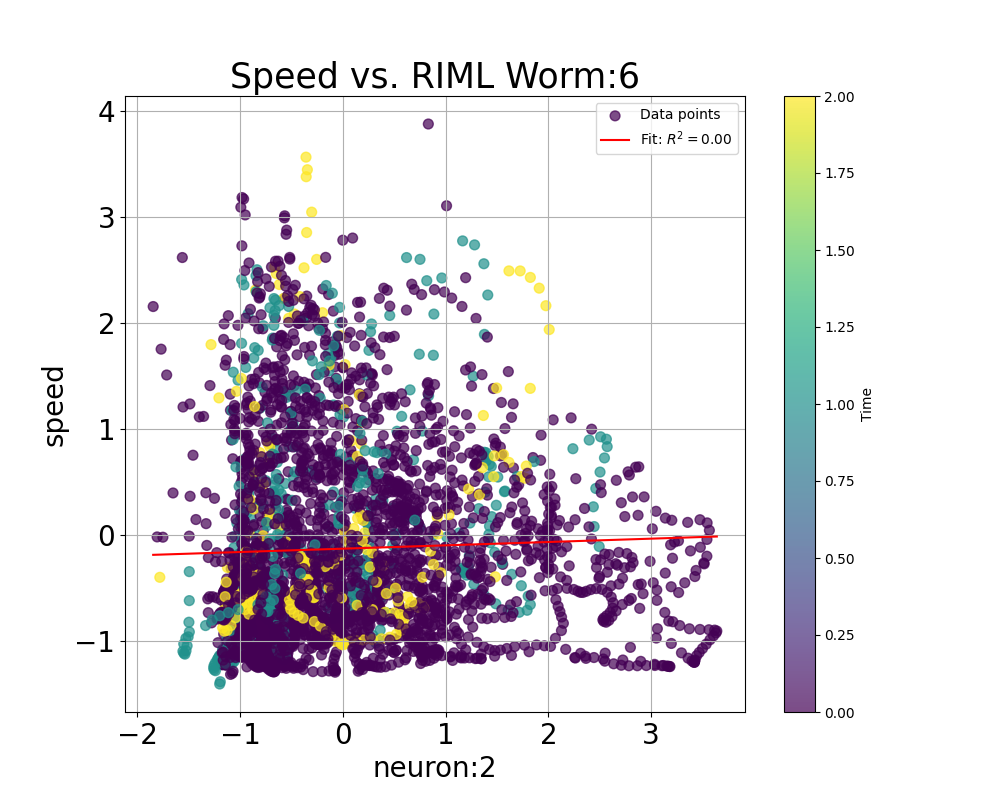

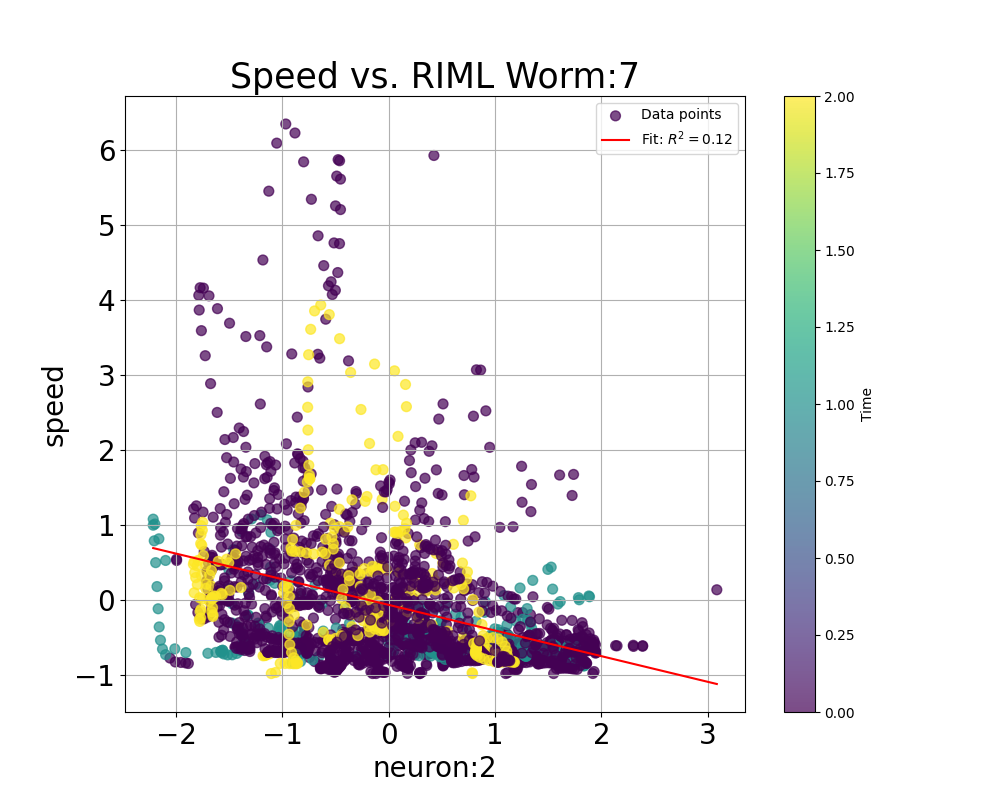

In [62]:
#titles =  ['HvectorBuffer2(t) vs n(t)','HvectorBuffer2((t) vs dn/d2t','HvectorBuffer2((t) vs d^2n/dt^2','HvectorBuffer2((t) vs dn/dt','HvectorBuffer2((t) vs dn/dt+s']
importlib.reload(AllF)
Set1 = "Speed vs. RIML"#'RIMvsRIB-IAA2'
vchoice1 = 13
n=2
for d in range(numWorms):
    if d>0 or not n in [5,3]:
        st = 0#AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,2]))
        end = L[d]#AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,3]))#L[d]    
        V = AllF.compute_vector_z_score(copy.deepcopy(MegaData[d,st:end,vchoice1]))
        V[np.isinf(V)]=0
        V[np.isnan(V)]=0
        Act = AllF.compute_vector_z_score(copy.deepcopy(MegaData[d,st:end,n]))
        Act2 = AllF.compute_vector_z_score(copy.deepcopy(MegaData[d,st:end,n+1]))
        #Act = (Act+Act2)/2
        AllF.plot_scatter_with_fit(Act, V, MegaData0[d,st:end,10],xlab="neuron:"+str(n),ylab="speed",titre= Set1 +' Worm:'+str(d))

Vchoice:14
v_center_signed_long


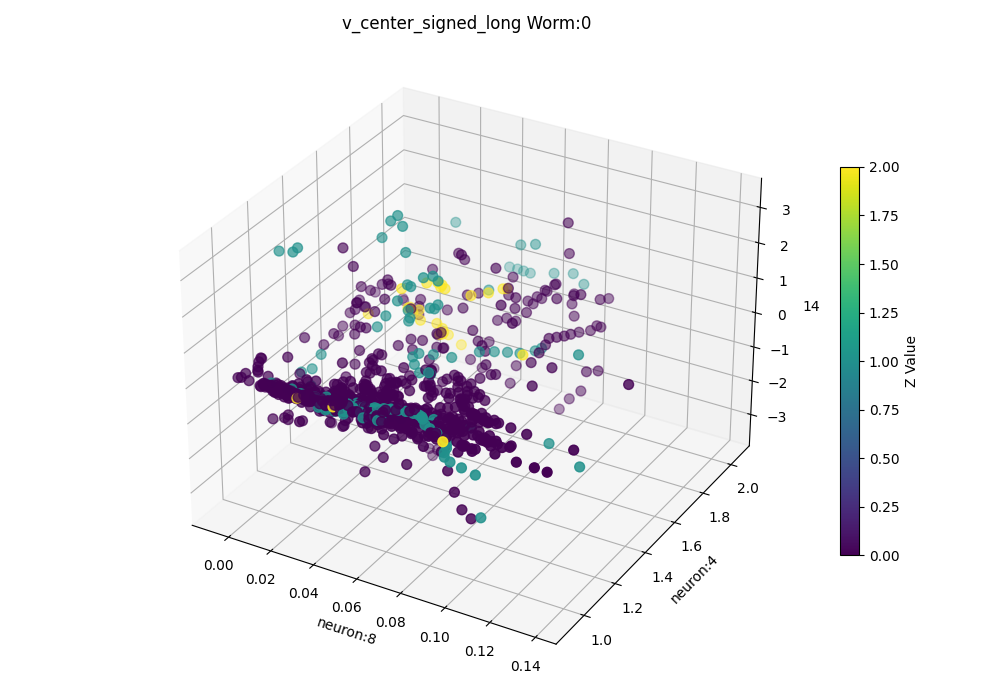

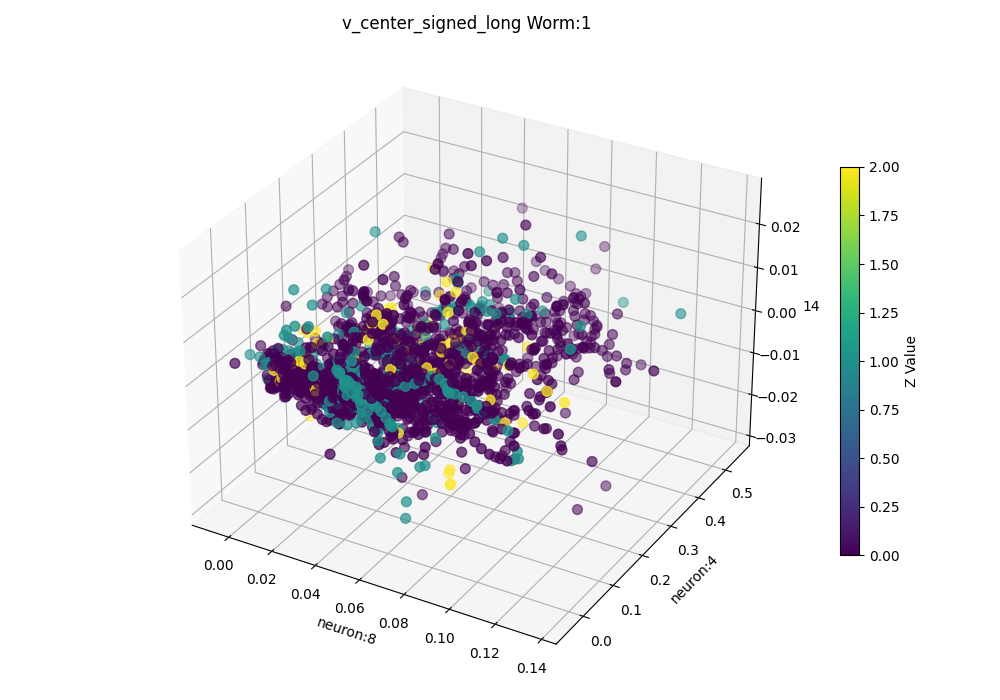

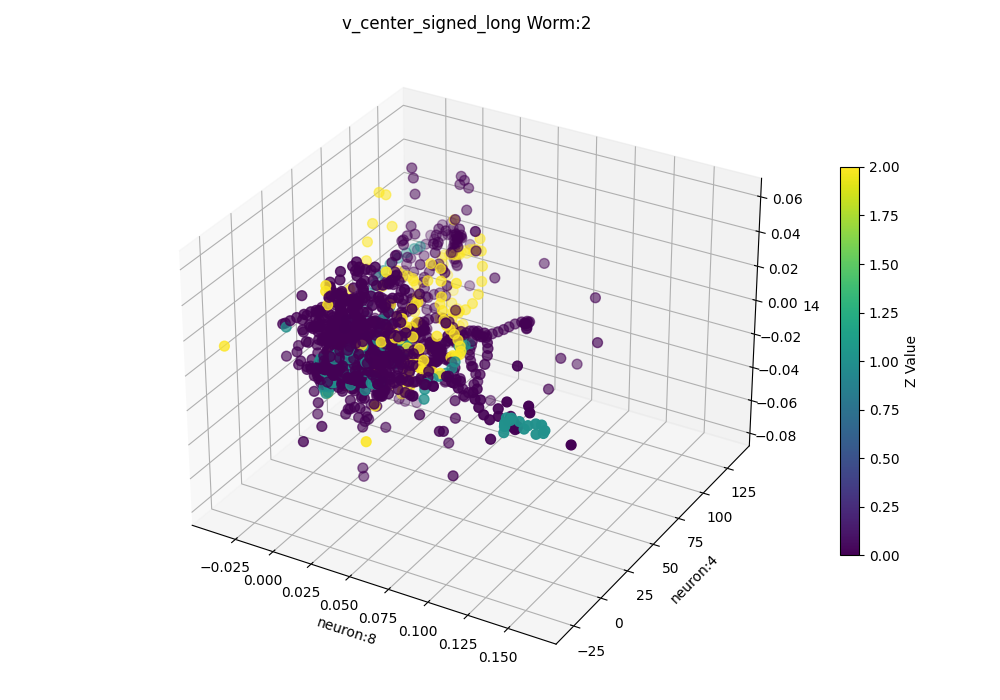

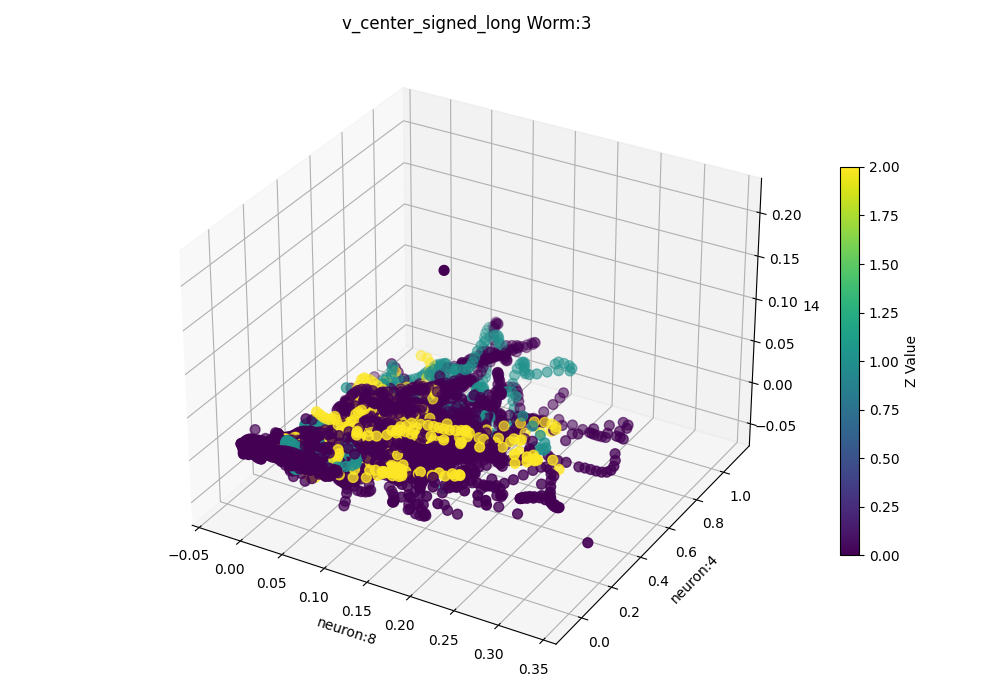

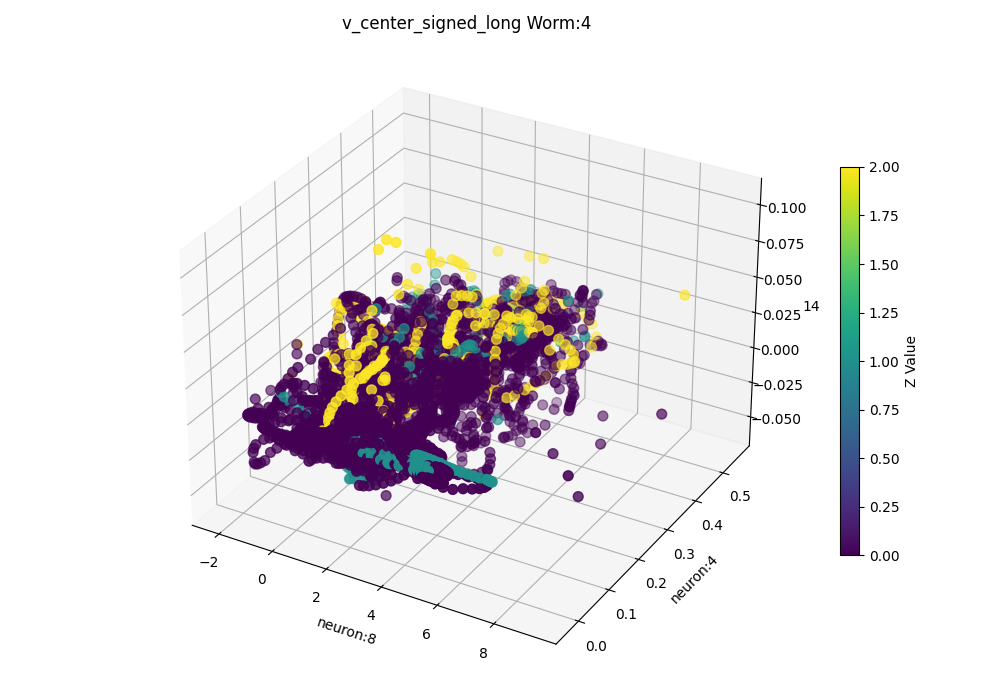

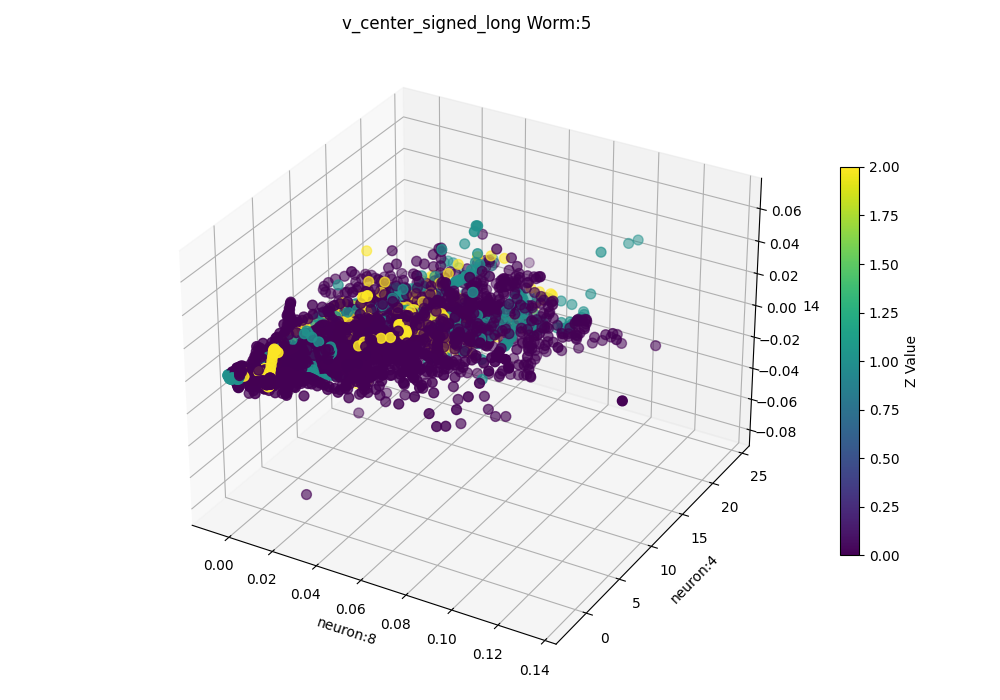

In [63]:
importlib.reload(AllF)

n1 = 8
n2 = 4
print("Vchoice:"+str(vchoice))
print(Set)
for d in range(6):
    st = 0#AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,0]))
    end = L[d]# AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,1]))#L[d]    
    #V = AllF.cross_product_vector_angle(MegaData[d,st:end,51:53], x0)
    #V[sm[d]:] = V[sm[d]:]-V[:-sm[d]]
    V = copy.deepcopy(MegaData[d,st:end,vchoice])
    V[np.isinf(V)]=0
    V[np.isnan(V)]=0
    Act1 = copy.deepcopy(MegaData[d,st:end,n1])
    Act2 = copy.deepcopy(MegaData[d,st:end,n2])
    AllF.plot_scatter_3d(Act1,Act2,V,MegaData0[d,st:end,10],xlab="neuron:"+str(n1),ylab="neuron:"+str(n2),zlab=str(vchoice),
                         titre=Set +' Worm:'+str(d))

Vchoice:16
v_center_signed_long
0.07675730006334804
3.5768885937897403


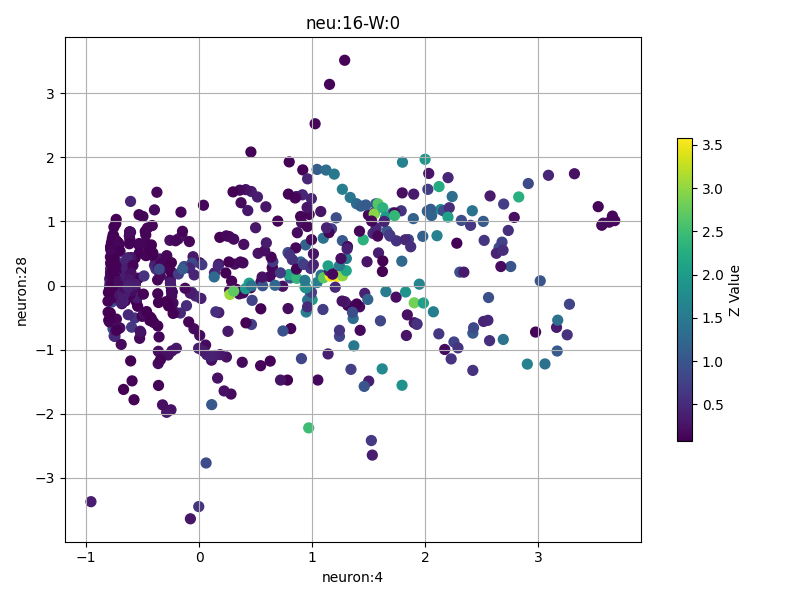

0.003413651232436541
0.03832885556483068


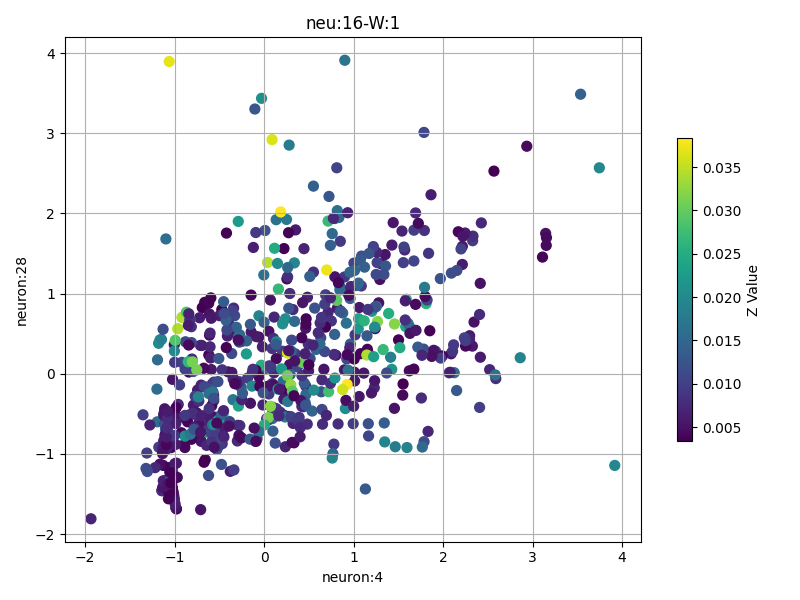

0.00815540685837082
0.08469506901609306


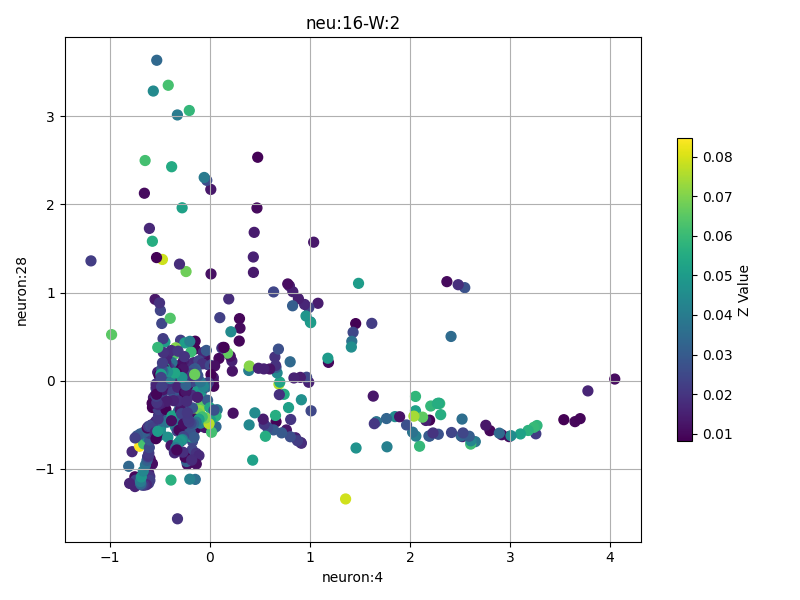

0.008234771046236485
0.07381479120755084


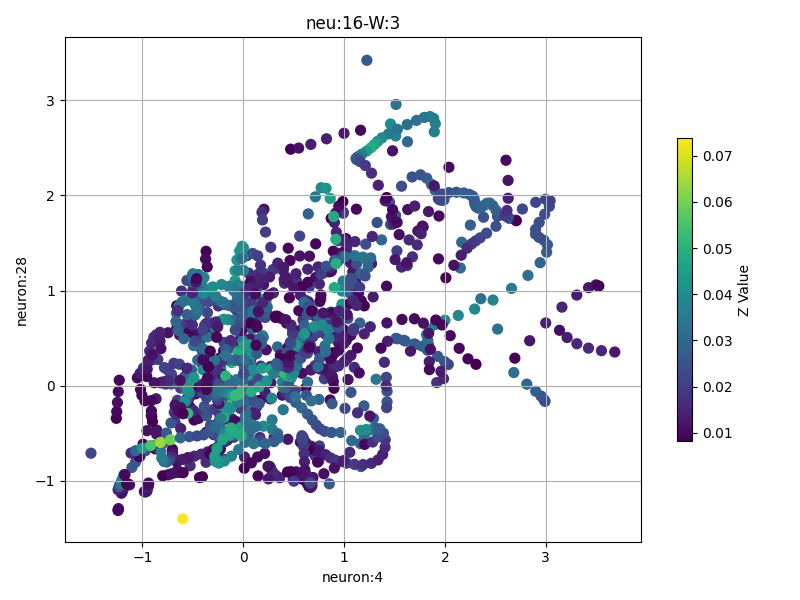

0.012422865124731506
0.1341976345610819


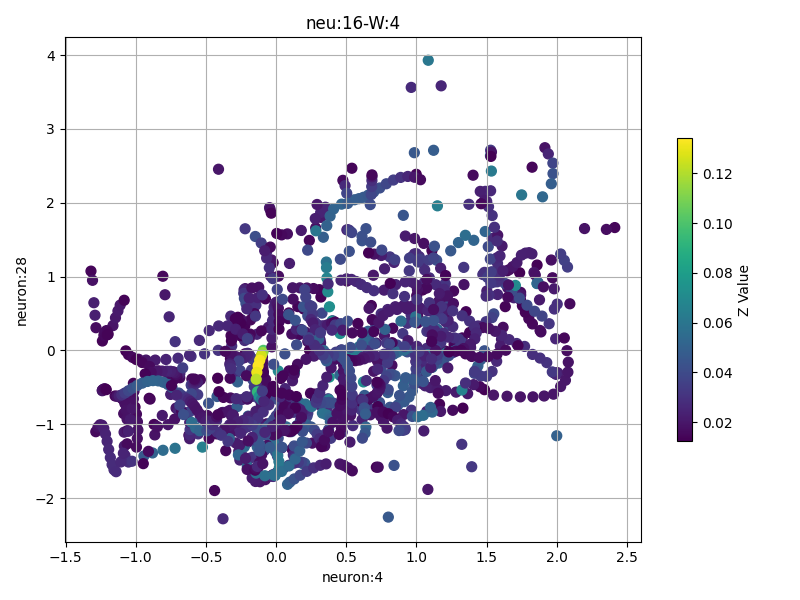

0.006606293969750168
0.08385703584654952


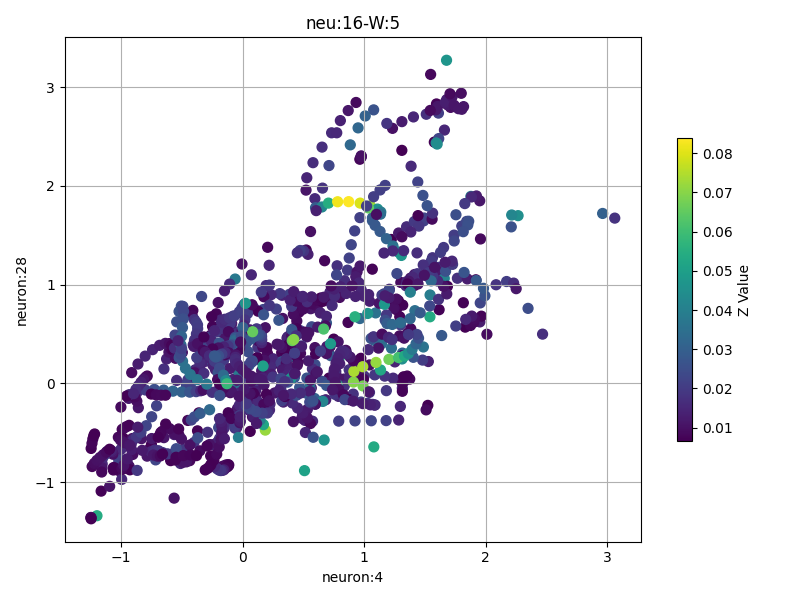

In [64]:
importlib.reload(AllF)

n1 = 4
n2 = 28
vchoice = 16
print("Vchoice:"+str(vchoice))
print(Set)
for d in range(6):
    st = 0#AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,0]))
    end = L[d]# AllF.closest_index(MegaData0[d,:L[d],12], int(IAA_int[d,1]))#L[d]    
    #V = AllF.cross_product_vector_angle(MegaData[d,st:end,51:53], x0)
    #V[sm[d]:] = V[sm[d]:]-V[:-sm[d]]
    V = copy.deepcopy(MegaData[d,st:end,vchoice])
    V[np.isinf(V)]=0
    V[np.isnan(V)]=0
    Act1 = AllF.compute_vector_z_score(copy.deepcopy(MegaData[d,st:end,n1]))
    Act2 = AllF.compute_vector_z_score(copy.deepcopy(MegaData[d,st:end,n2]))
    AllF.plot_scatter_3dpercentile(Act1,Act2,V,MegaData[d,st:end,16],70,100,xlab="neuron:"+str(n1),ylab="neuron:"+str(n2)
                                   ,titre='neu:'+str(vchoice)+'-W:'+str(d))

sacel:1.2514438011336846
d:0
(0.6364894383156912, 0.6364894383156917)
(0.42577659076336927, 0.4257765907633695)
sacel:0.018290901736474314
d:1
(-0.3733807172600476, -0.37338071726004723)
(-0.02212582802897211, -0.022125828028972165)
sacel:0.04388320036761322
d:2
(0.08614853121016487, 0.08614853121016502)
(0.10384632068226043, 0.10384632068226045)
sacel:0.027031557385929262
d:3
(-0.582141006727268, -0.5821410067272681)
(0.4564677608125669, 0.45646776081256707)
sacel:0.03732608626878784
d:4
(-0.3411023291006947, -0.3411023291006949)
(0.028217509467922394, 0.028217509467922407)
sacel:0.026215355751165823
d:5
(0.27585236412137026, 0.27585236412137026)
(-0.4184158676835945, -0.4184158676835944)
sacel:0.02896088902631633
d:6
(0.5169762866515912, 0.5169762866515913)
(-0.12694757200581913, -0.12694757200581935)
sacel:0.022555313006147056
d:7
(-0.04032691497319424, -0.04032691497319413)
(-0.17889890622147833, -0.1788989062214781)


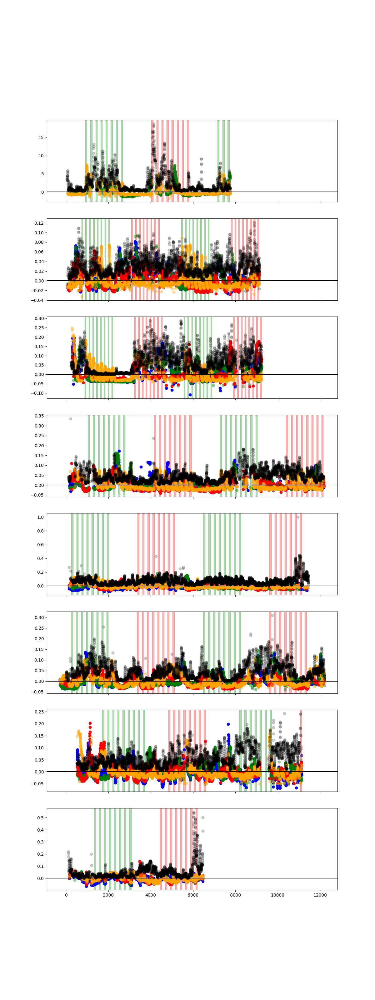

In [68]:
vchoice = 15
nchoice = 3
nchoice1 = 2
numWorms = 8
timfr = 11
nchoice2 = 5
nchoice22 = 6
scale =[]
fig, axes = plt.subplots(numWorms, 1, figsize=(12, numWorms*4), sharex=True)
for d in range(numWorms):
    st=0
    end =  L[d]
    ax = axes[d]
    startIAA,EndIAA = AllF.get_nonzero_start_end(MegaData0[d,st:end,10]==1)
    start2NN,End2NN = AllF.get_nonzero_start_end(MegaData0[d,st:end,10]==2)
    for o in range(len(startIAA)):
        ax.axvspan(MegaData[d,startIAA[o],timfr],MegaData[d,EndIAA[o],timfr], color='green',alpha=0.3)
    for o in range(len(start2NN)):    
        ax.axvspan(MegaData[d,start2NN[o],timfr],MegaData[d,End2NN[o],timfr], color='red',alpha=0.3)
    V = MegaData[d,st:L[d],vchoice]
    scale = np.percentile(np.abs(V), 70)
    print("sacel:"+str(scale))
    Act = MegaData[d,st:L[d],nchoice]
    Act2 = MegaData[d,st:L[d],nchoice2]
    Act1 = MegaData[d,st:L[d],nchoice1]
    Act22 = MegaData[d,st:L[d],nchoice22]
    time = MegaData[d,st:L[d],timfr]
    nonz = np.nonzero(V)
    nonzA = np.nonzero(Act)
    nonzA1 = np.nonzero(Act1)
    nonzA2 = np.nonzero(Act2)
    nonzA22 = np.nonzero(Act22)
    ax.scatter(time[nonzA[0]],AllF.compute_vector_z_score(Act[nonzA[0]])*scale,c='blue')
    #ax.scatter(time[nonzA[0]],Act[nonzA[0]],c='blue')
    ax.scatter(time[nonzA1[0]],AllF.compute_vector_z_score(Act1[nonzA1[0]])*scale,c='green',alpha=0.4)
    ax.scatter(time[nonzA2[0]],AllF.compute_vector_z_score(Act2[nonzA2[0]])*scale,c='red')
    ax.scatter(time[nonzA22[0]],AllF.compute_vector_z_score(Act22[nonzA22[0]])*scale,c='orange',alpha=0.4)
    ax.scatter(time[nonz[0]+st],V[nonz[0]+st]*2,alpha=0.2,c='black')
    stind = int(IAA_int[d,1])
    endin = int(NN_int[d,0])
    print("d:"+str(d))
    print(AllF.compute_2rows(AllF.compute_vector_z_score(Act1[stind:endin])*scale,V[stind:endin]))
    print(AllF.compute_2rows(AllF.compute_vector_z_score(Act22[stind:endin])*scale,V[stind:endin]))
    ax.axhline(0, color='black')
plt.show()    

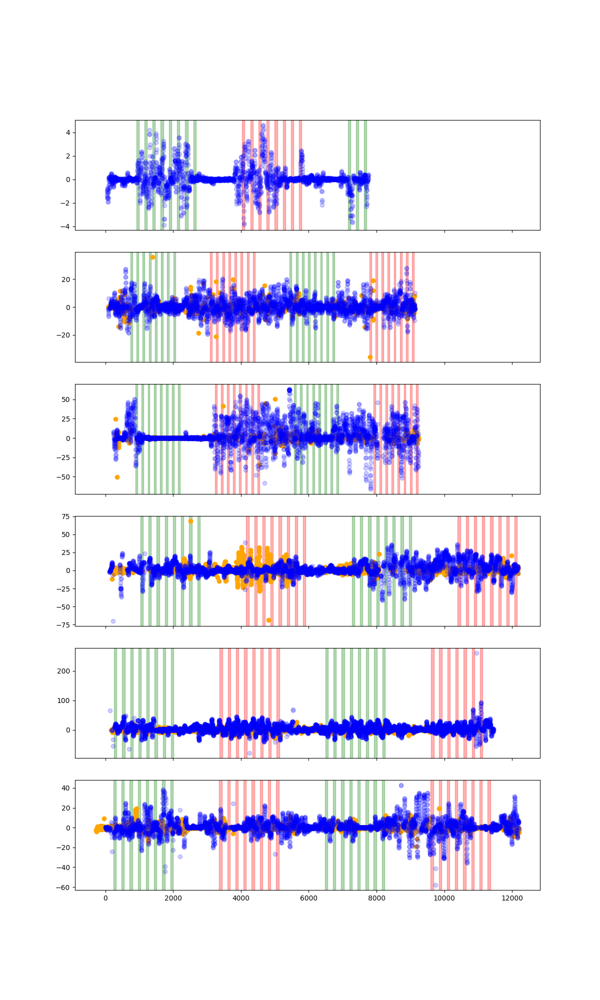

In [173]:
vchoice = 16
vchoice2 = vchoice
nchoice = 3
numWorms = 5
timfr = 11
nchoice2 = nchoice
fig, axes = plt.subplots(6, 1, figsize=(12, numWorms*4), sharex=True)
for d in range(6):
    st=0
    end =  L[d]
    ax = axes[d]
    startIAA,EndIAA = AllF.get_nonzero_start_end(MegaData0[d,st:end,10]==1)
    start2NN,End2NN = AllF.get_nonzero_start_end(MegaData0[d,st:end,10]==2)
    for o in range(len(startIAA)):
        ax.axvspan(MegaData[d,startIAA[o],timfr],MegaData[d,EndIAA[o],timfr], color='green',alpha=0.3)
    for o in range(len(start2NN)):    
        ax.axvspan(MegaData[d,start2NN[o],timfr],MegaData[d,End2NN[o],timfr], color='red',alpha=0.3)
    V = MegaData[d,st:L[d],vchoice]
    V2 = Deriv[d,st:L[d],vchoice]
    
    Act = MegaData[d,st:L[d],nchoice]
    Act2 = Deriv[d,st:L[d],nchoice2]
    time = MegaData[d,st:L[d],timfr]
    nonz = np.nonzero(V)
    nonzV2 = np.nonzero(V2)
    nonzA = np.nonzero(Act)
    nonzA2 = np.nonzero(Act2)
    #ax.scatter(time[nonzA[0]],AllF.compute_vector_z_score(Act[nonzA[0]])*20,c='red')
    #ax.scatter(time[nonzA[0]],Act[nonzA[0]],c='blue')
    #ax.scatter(time[nonzA2[0]],AllF.compute_vector_z_score(Act2[nonzA2[0]])*20,c='orange',alpha=0.4))
    ax.scatter(time[nonzA2[0]],(Act2[nonzA2[0]]),c='orange')#,alpha=0.4)
    ax.scatter(time[nonz[0]+st],V[nonz[0]+st],c='blue',alpha=0.2)
    #ax.scatter(time[nonzV2[0]+st],V2[nonzV2[0]+st],c='green',alpha=0.4)

ValueError: zero-size array to reduction operation minimum which has no identity

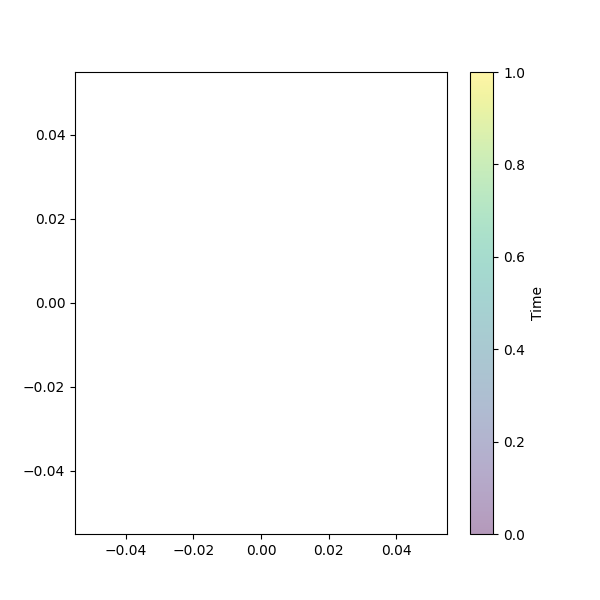

In [177]:
importlib.reload(AllF)
for d in range(6):
    st=0
    end =int(L[d]/4)
    X = AllF.binarize_with_threshold(AllF.compute_vector_z_score(MegaData[d,st:end,nchoice]),0,-0.1)
    Y = AllF.binarize_with_threshold(Deriv[d,st:end,vchoice],threshPos[d],threshNeg[d])
    T = np.ones(end-st)#MegaData[d,st:end,11]
    f = AllF.plot_scatter_overlap_jitter(X,Y,T,
                    xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d),jitter = 0.2)

In [175]:
importlib.reload(AllF)
pos = [0.1,0.1,0.1,0.1,0.1,0.1]
vpos = [3,3,3,6,6,6]
vchoice = 22
print("v:"+str(vchoice))
for d in range(1,6):
    st=0
    end =int(L[d]/4)
    X = AllF.binarize_with_threshold(Deriv[d,st:end,nchoice],0.05,-0.05)
    Y = AllF.binarize_with_threshold(MegaData[d,st:end,vchoice],0.05,-0.05)#,threshPos[d],threshNeg[d])
    T = np.ones(end-st)#MegaData[d,st:end,11]#np.ones(end-st)#MegaData[d,st:end,11]
    f =AllF.plot_scatter_overlap_jitter(X,Y,T,
                             xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d),jitter = 0.2)
    f =AllF.plot_scatter_with_fit(X,Y,T,
                             xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d))

v:22


NameError: name 'MegaData_derivative' is not defined

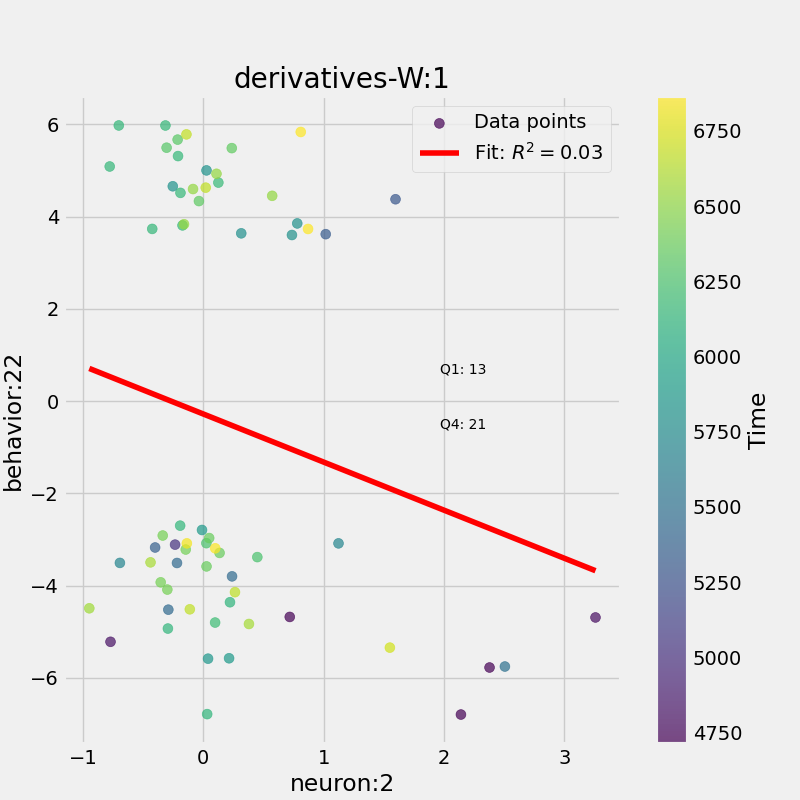

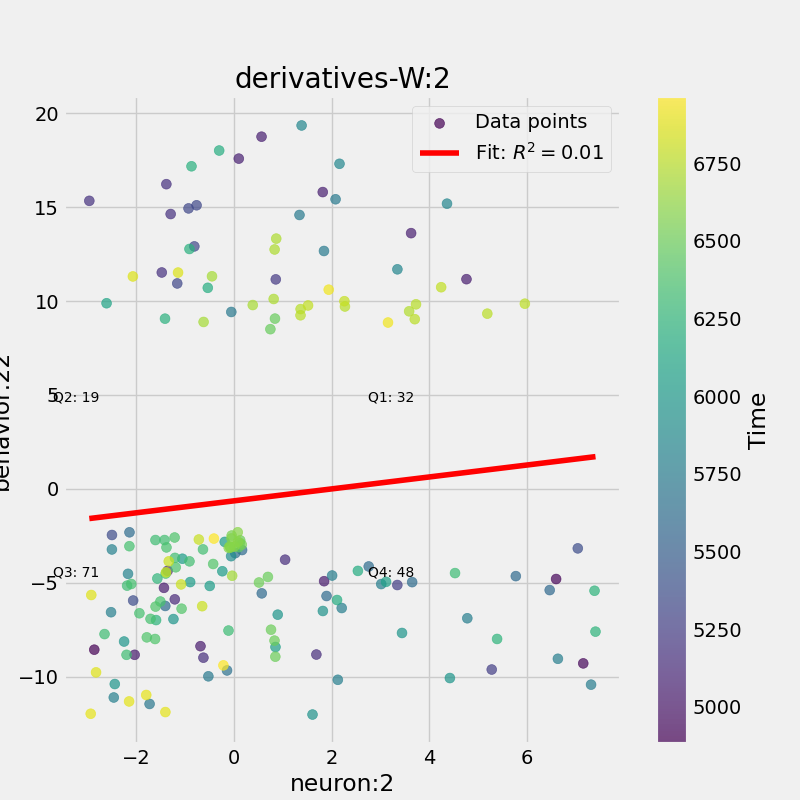

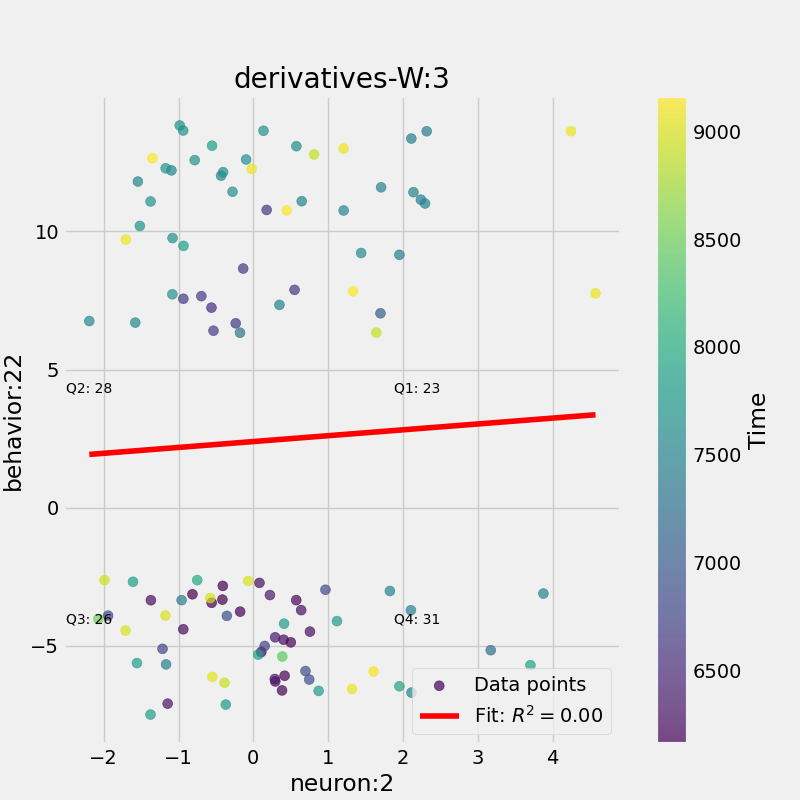

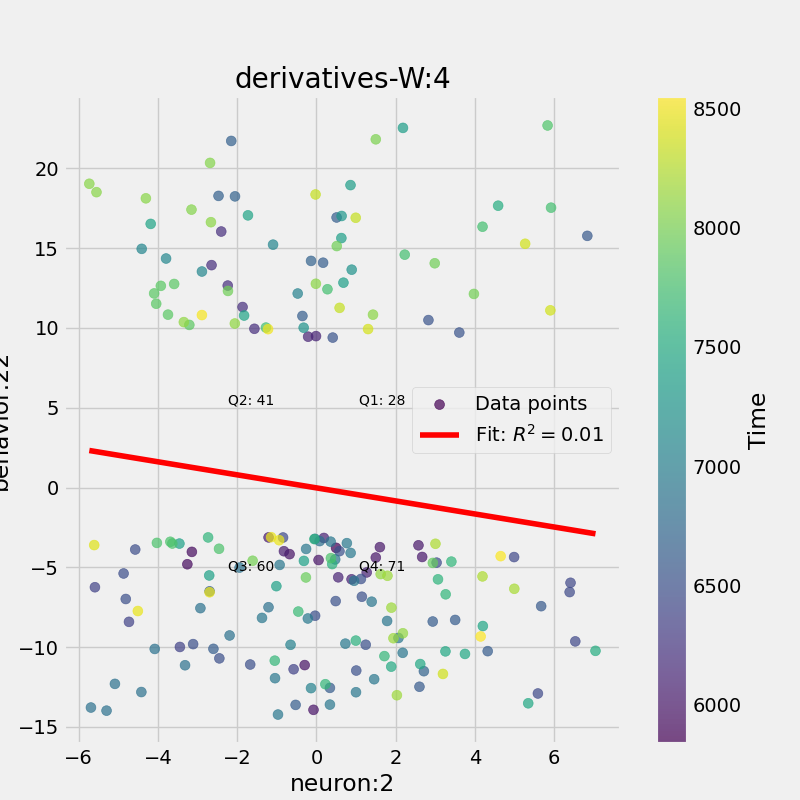

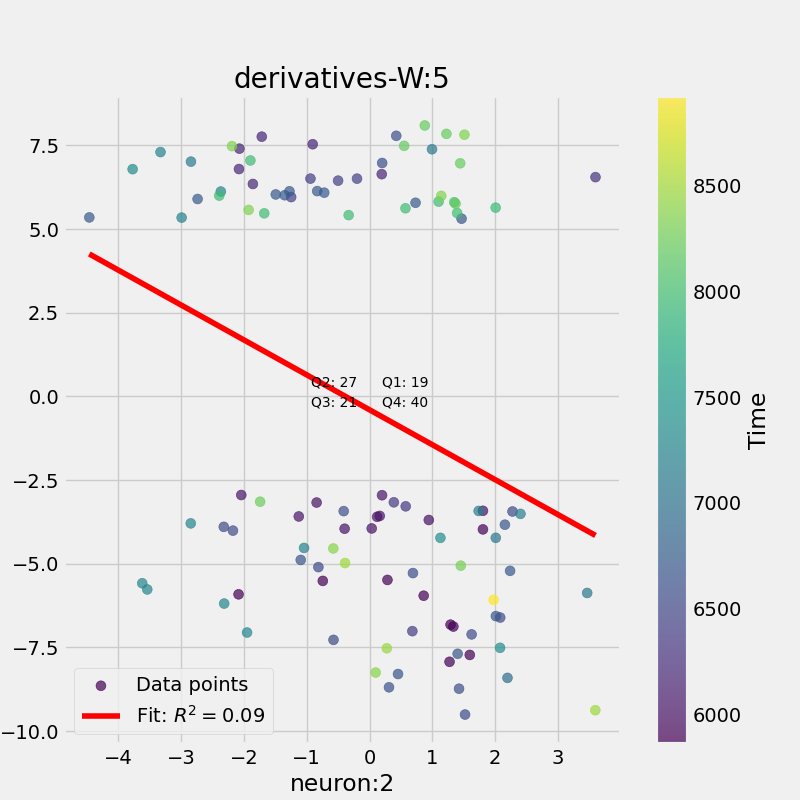

In [306]:
importlib.reload(AllF)
vchoice = 22
vchoice2 = vchoice
nchoice = 2
for d in range(1,6):
    st =int(2*L[d]/4)
    end =int(3*L[d]/4)
    #X = AllF.compute_vector_z_score(MegaData[d,st:end,nchoice])*20
    X = AllF.remove_nearZero(AllF.dropbottom5perc(AllF.droptop5perc(MegaData_derivative[d,st:end,nchoice],0.1),0.1))#MegaData_derivative[d,st:end,nchoice]
    Y = AllF.remove_nearZero(AllF.dropbottom5perc(AllF.droptop5perc(MegaData[d,st:end,vchoice],0.1),0.1),threshPos[d],threshNeg[d])
    T = MegaData[d,st:end,11]

    f =AllF.plot_scatter_with_fit(X,Y,T,
                             xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d))

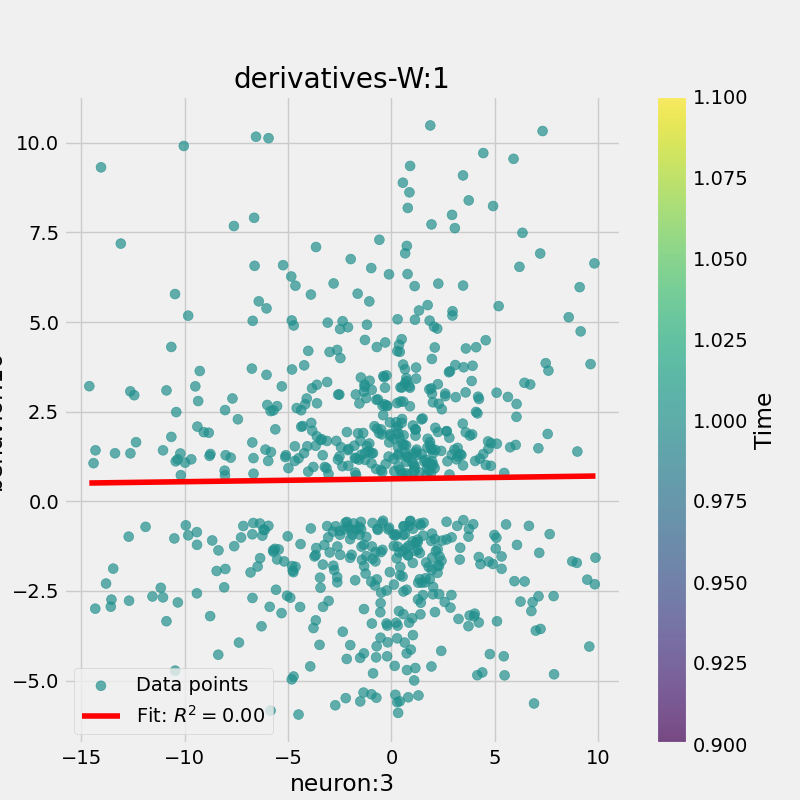

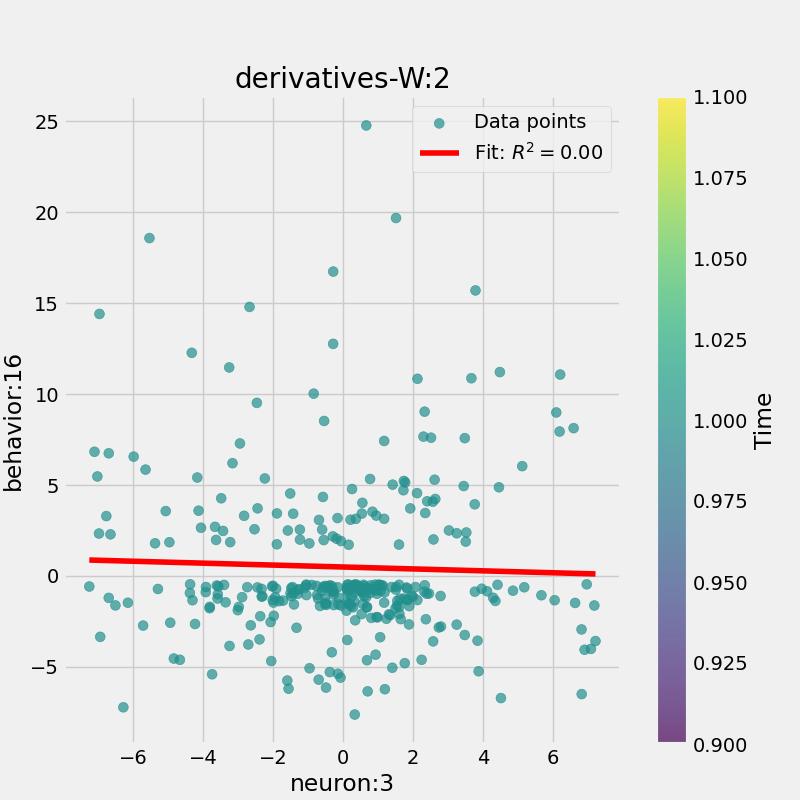

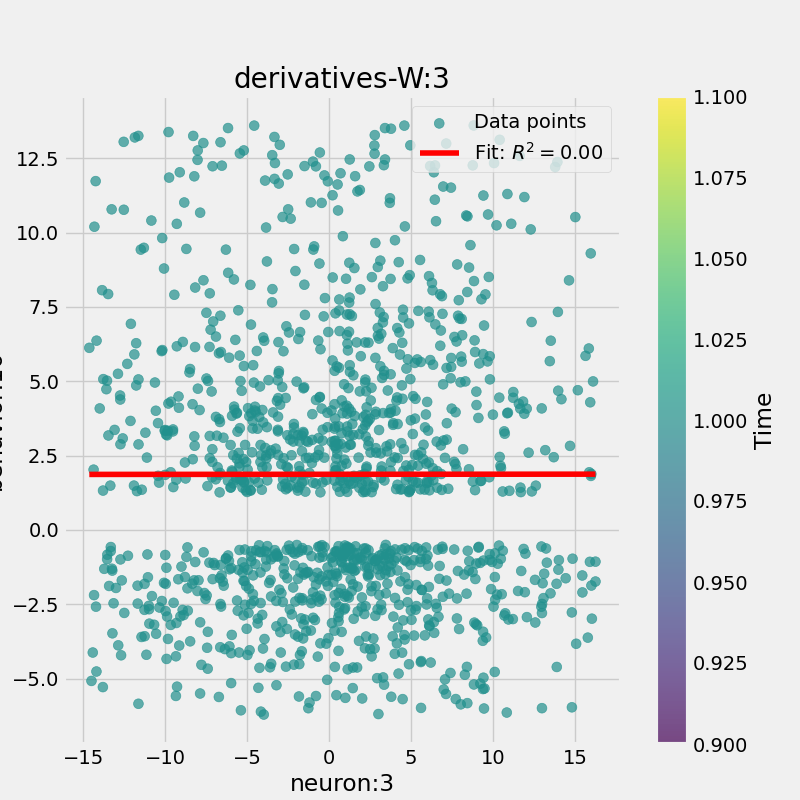

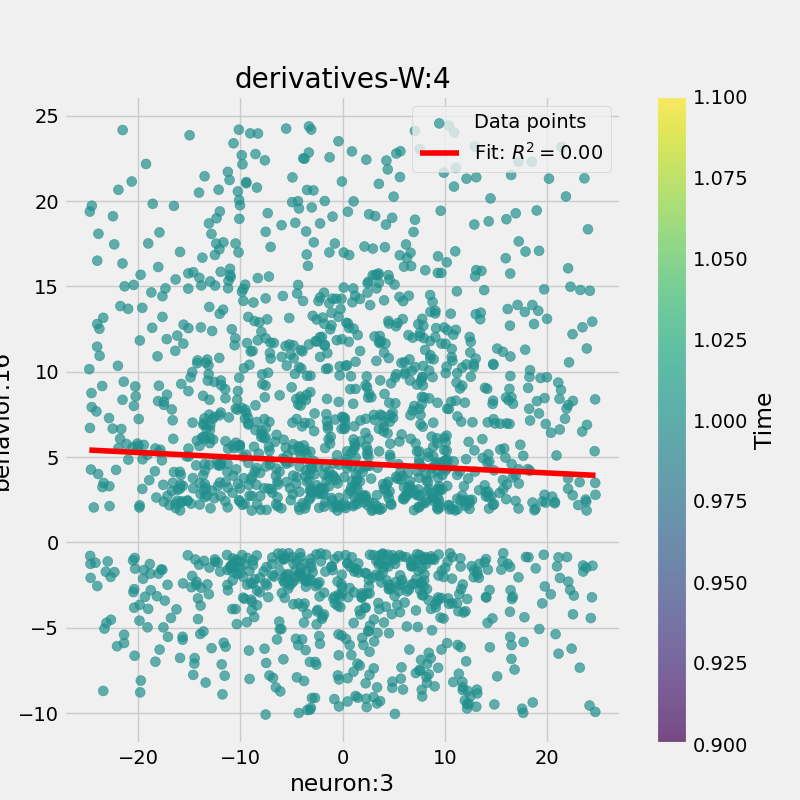

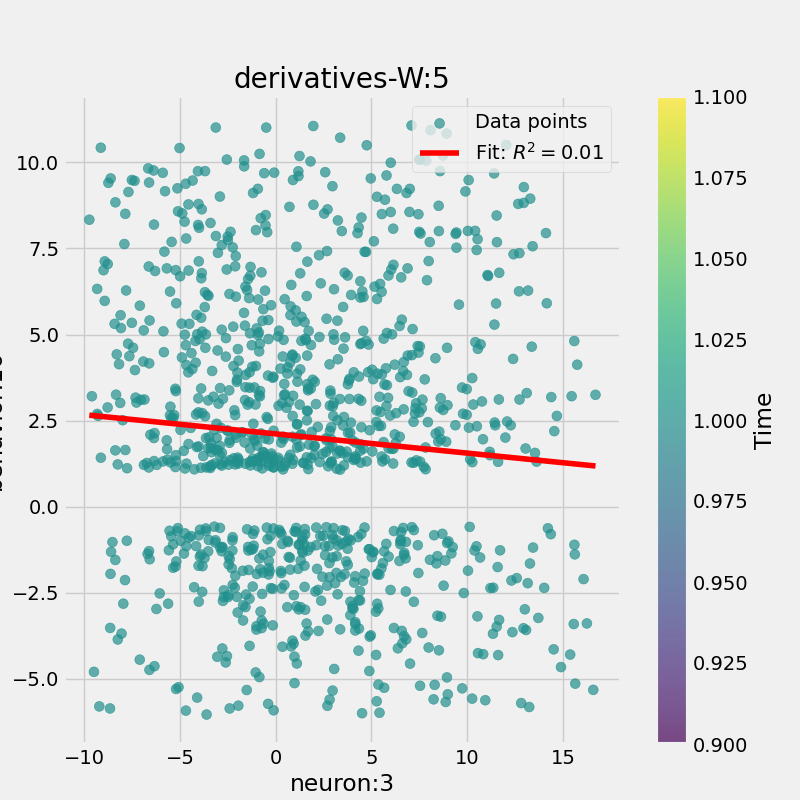

In [271]:
importlib.reload(AllF)
vchoice = 16
vchoice2 = vchoice
nchoice = 3
for d in range(1,6):
    st =0#int(2*L[d]/4)
    end =int(3*L[d]/4)
    #X = AllF.compute_vector_z_score(MegaData[d,st:end,nchoice])*20
    X = AllF.remove_nearZero(AllF.dropbottom5perc(AllF.droptop5perc(MegaData_2ndderivative[d,st:end,nchoice],0.1),0.1),0.1,-0.05)#MegaData_derivative[d,st:end,nchoice]
    Y = AllF.remove_nearZero(AllF.dropbottom5perc(AllF.droptop5perc(MegaData[d,st:end,vchoice],0.1),0.1),threshPos[d]/5,threshNeg[d]/5)
    T = np.ones(end-st)#MegaData[d,st:end,11]
    #f =AllF.plot_scatter_overlap(X,Y,T,
    #                         xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d))
    f =AllF.plot_scatter_with_fit(X,Y,T,
                             xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d))

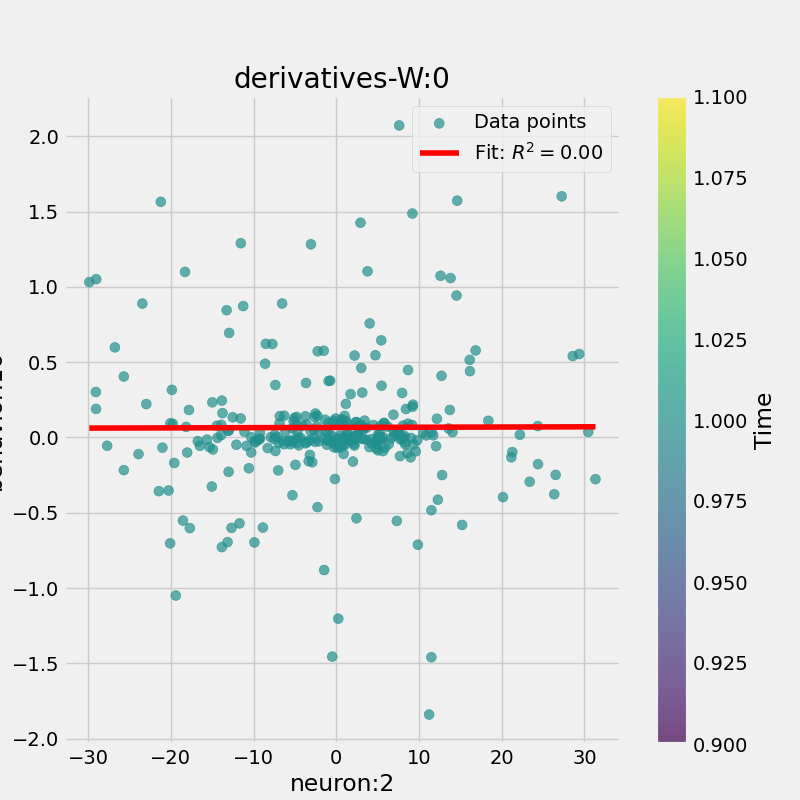

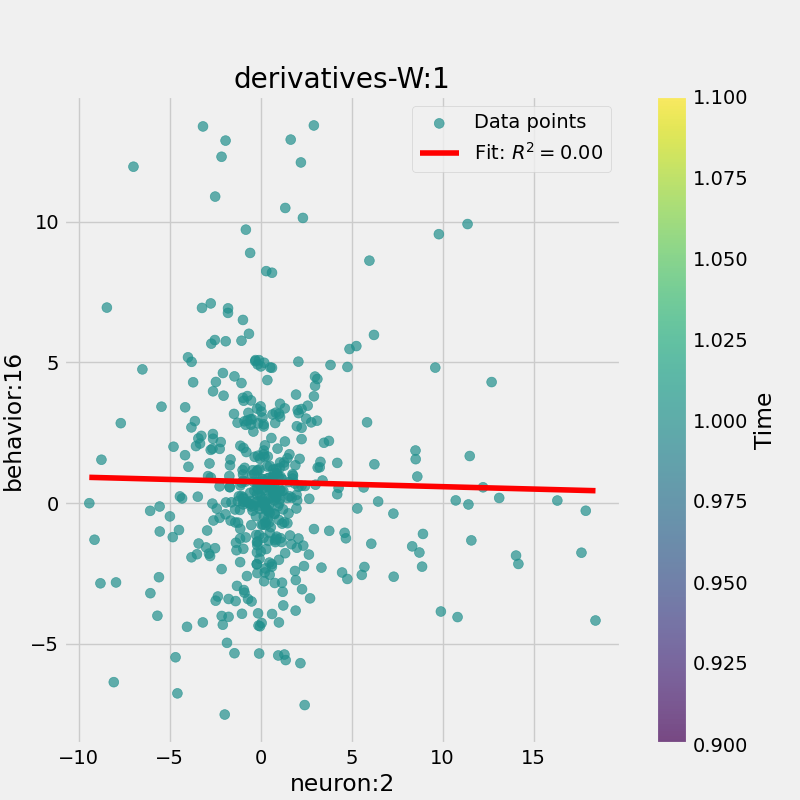

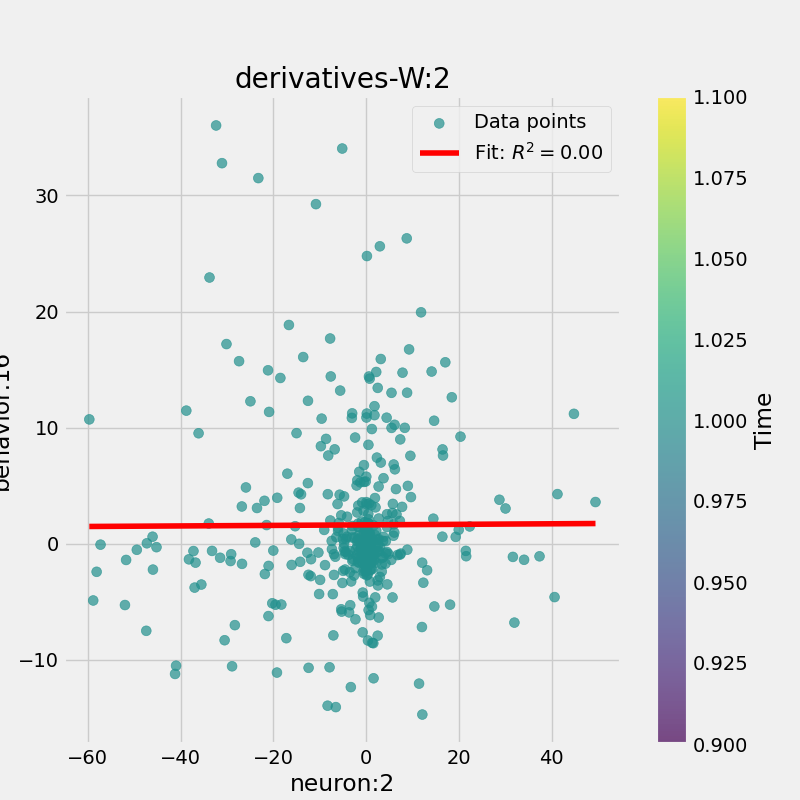

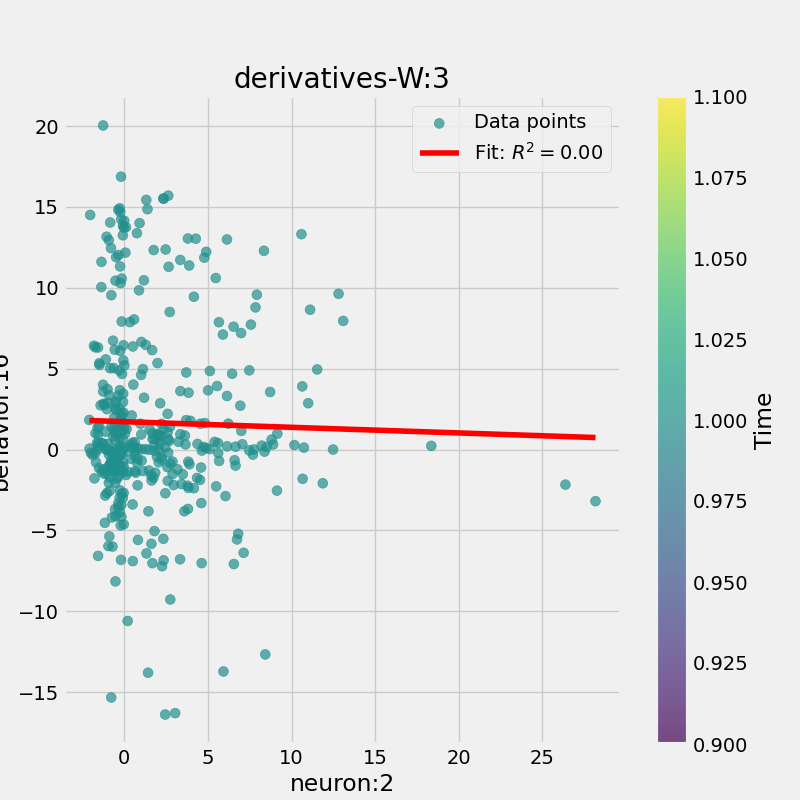

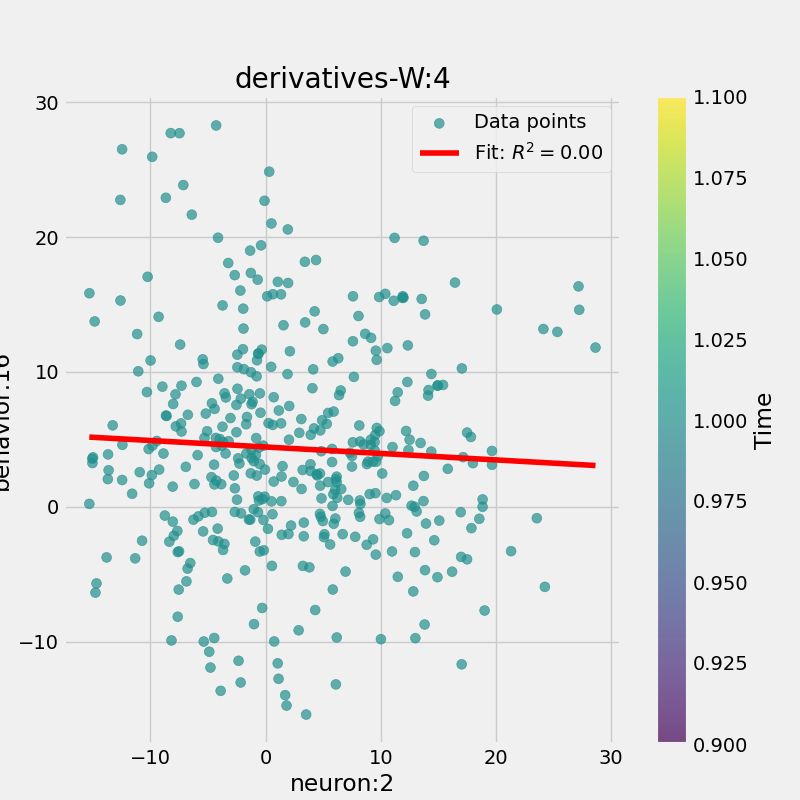

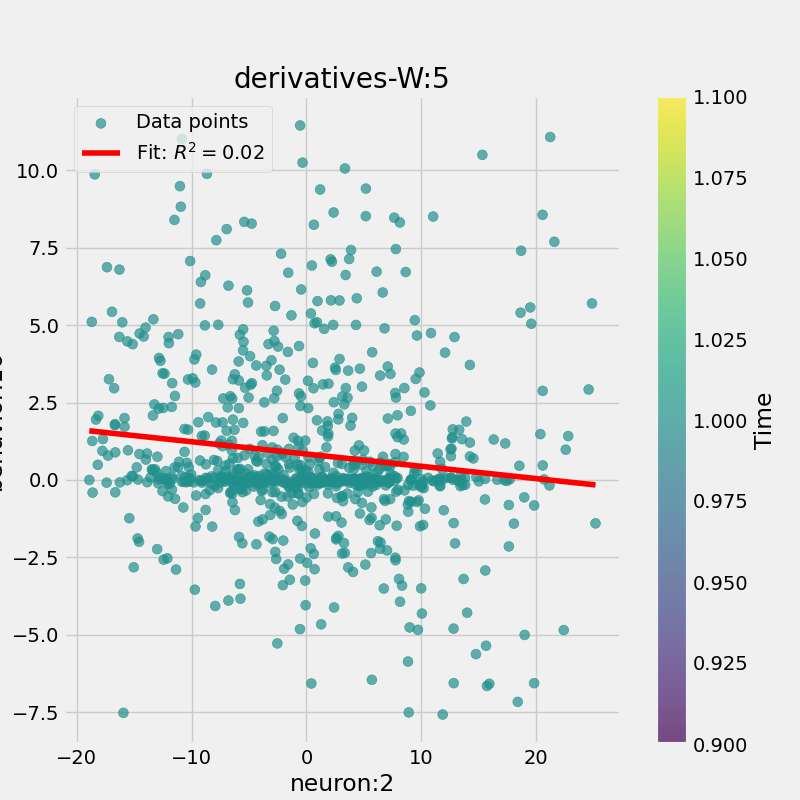

In [272]:
importlib.reload(AllF)
vchoice = 16
vchoice2 = vchoice
nchoice = 2
for d in range(6):
    st =int(2*L[d]/4)
    end =int(3*L[d]/4)
    #X = AllF.compute_vector_z_score(MegaData[d,st:end,nchoice])*20
    X = AllF.dropbottom5perc(AllF.droptop5perc(MegaData_derivative[d,st:end,nchoice]))#MegaData_derivative[d,st:end,nchoice]
    Y = AllF.dropbottom5perc(AllF.droptop5perc(MegaData[d,st:end,vchoice]))
    T = np.ones(end-st)#MegaData[d,st:end,11]
    #f =AllF.plot_scatter_overlap(X,Y,T,
    #                         xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d))
    f =AllF.plot_scatter_with_fit(X,Y,T,
                             xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d))

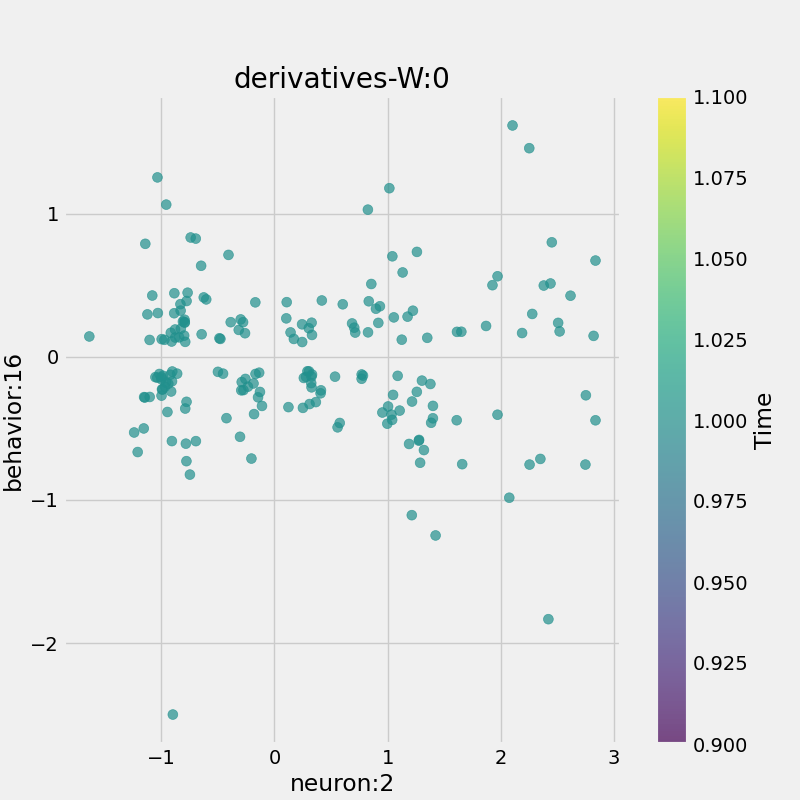

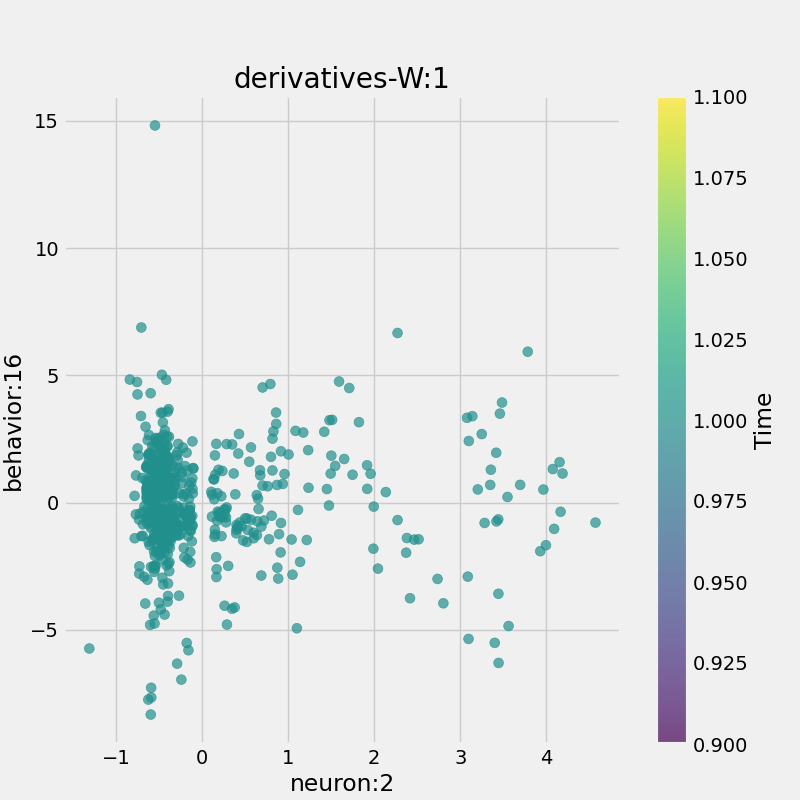

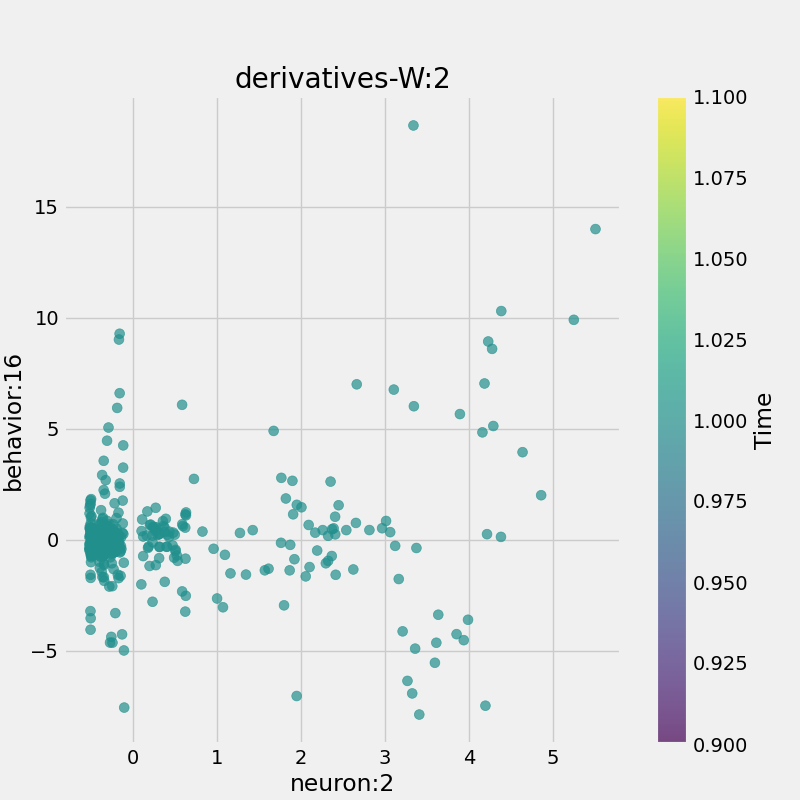

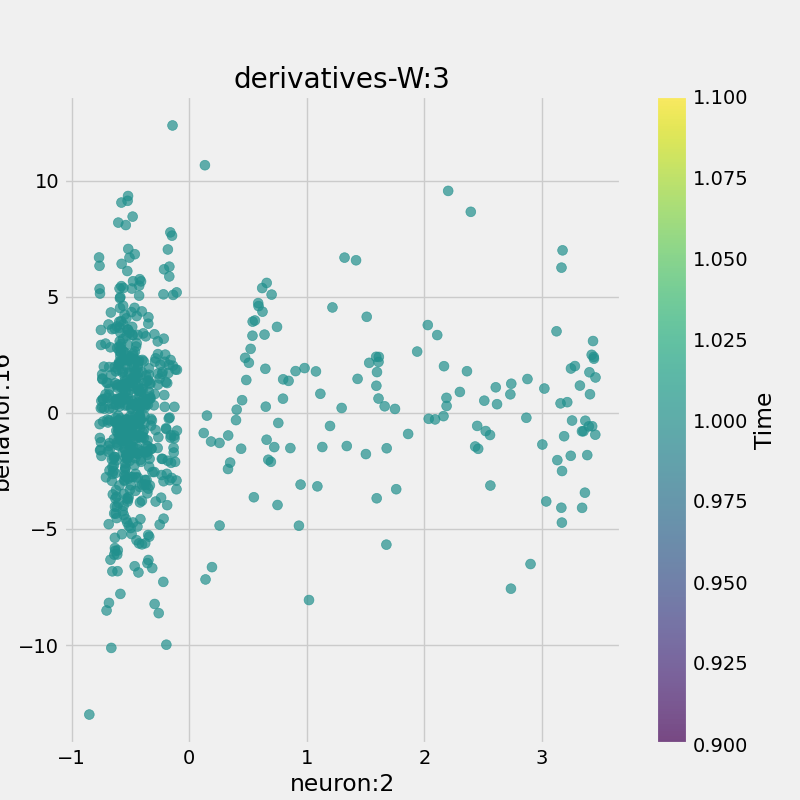

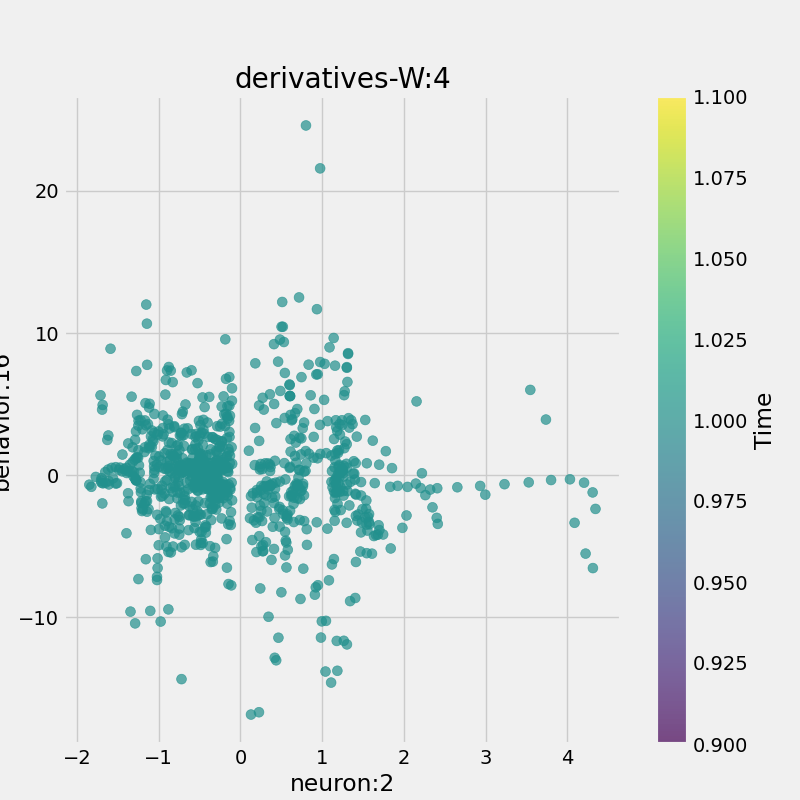

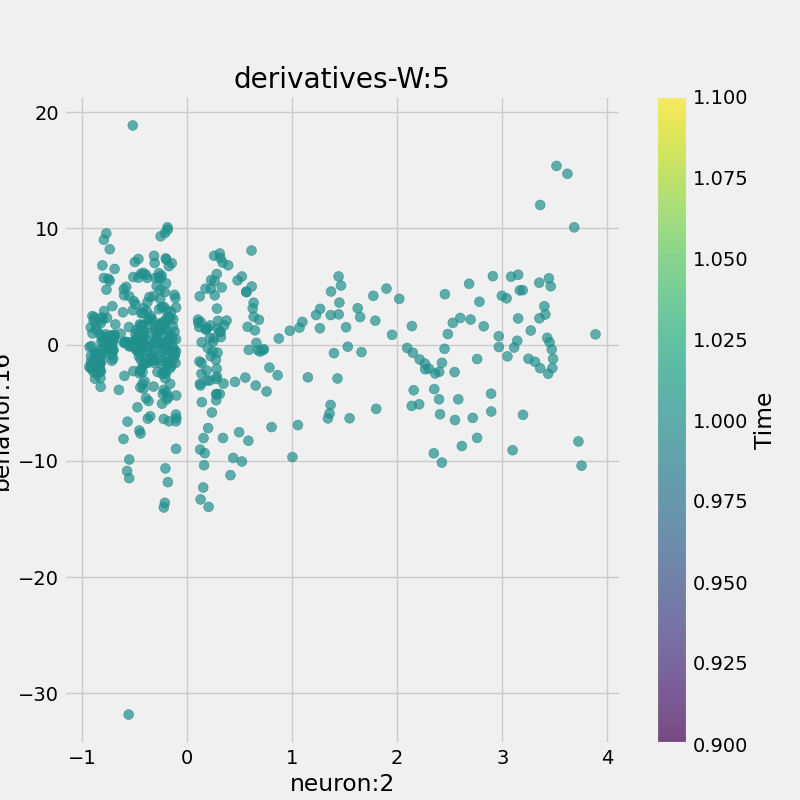

In [274]:
importlib.reload(AllF)
for d in range(6):
    st=0
    end =int(L[d]/4)
    X = AllF.remove_nearZero(AllF.compute_vector_z_score(MegaData[d,st:end,nchoice]),0.1,-0.1)#MegaData_derivative[d,st:end,nchoice]
    Y = AllF.remove_nearZero(MegaData_2ndderivative[d,st:end,vchoice],0.1,-0.1)
    T = np.ones(end-st)#MegaData[d,st:end,11]
    f =AllF.plot_scatter_overlap(X,Y,T,
                             xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d))

In [180]:
vchoice = 16
vchoice2 = vchoice
nchoice = 3
for d in range(6):
    end =int(L[d]/4)
    X = AllF.compute_vector_z_score(MegaData[d,st:end,nchoice])*20
    #X = AllF.remove_nearZero(AllF.compute_vector_z_score(MegaData[d,st:end,nchoice]),0.1,-0.1)#MegaData_derivative[d,st:end,nchoice]
    Y = Deriv[d,st:end,vchoice]
    T = np.ones(end-st)#MegaData[d,st:end,11]
    f =AllF.plot_scatter_overlap(X,Y,T,
                             xlab='neuron:'+str(nchoice),ylab='behavior:'+str(vchoice),titre='derivatives-W:'+str(d))

ValueError: negative dimensions are not allowed

NameError: name 'time_bins' is not defined

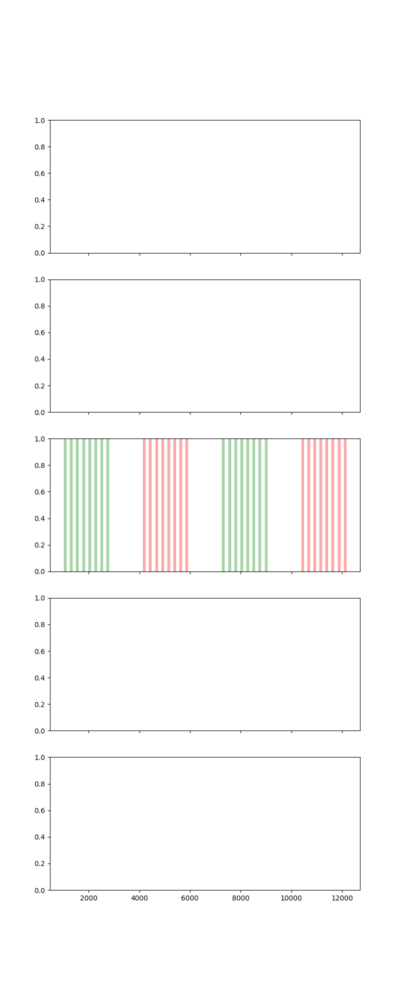

In [178]:
vchoice = 14
nchoice = 4
numWorms = 5
timfr = 11
fig, axes = plt.subplots(5, 1, figsize=(8, numWorms*4), sharex=True)
for d in range(3,6):
    st=0
    end =  L[d]
    ax = axes[d-1]
    startIAA,EndIAA = AllF.get_nonzero_start_end(MegaData0[d,st:end,10]==1)
    start2NN,End2NN = AllF.get_nonzero_start_end(MegaData0[d,st:end,10]==2)
    for o in range(len(startIAA)):
        ax.axvspan(MegaData[d,startIAA[o],timfr],MegaData[d,EndIAA[o],timfr], color='green',alpha=0.3)
    for o in range(len(start2NN)):    
        ax.axvspan(MegaData[d,start2NN[o],timfr],MegaData[d,End2NN[o],timfr], color='red',alpha=0.3)
    V = MegaData[d,st:L[d],vchoice]
    Act = MegaData[d,st:L[d],nchoice]
    time = MegaData[d,st:L[d],timfr]
    nonz = np.nonzero(V)
    if timfr==11:
        ax.bar(AllF.convert_lower_to_upper_series(time_bins[d,:b[d]],MegaData[d,:L[d],:]),Velocity_bins[d,:b[d]])#Velocity_bins
        ax.bar(AllF.convert_lower_to_upper_series(time_bins[d,:b[d]],MegaData[d,:L[d],:]),activity_bins[d,nchoice,:b[d]]*10, alpha=0.7)
    else:
        ax.bar((time_bins[d,:b[d]]),Velocity_bins[d,:b[d]])
        ax.bar(time_bins[d,:b[d]],activity_bins[d,nchoice,:b[d]]*10, alpha=0.7,wisth=3)
    ax.scatter(time[nonz[0]+st],V[nonz[0]+st],alpha=0.4)
    #ax.scatter(time[nonz[0]],MegaData[d,nonz[0],10]*10)


1270
1275


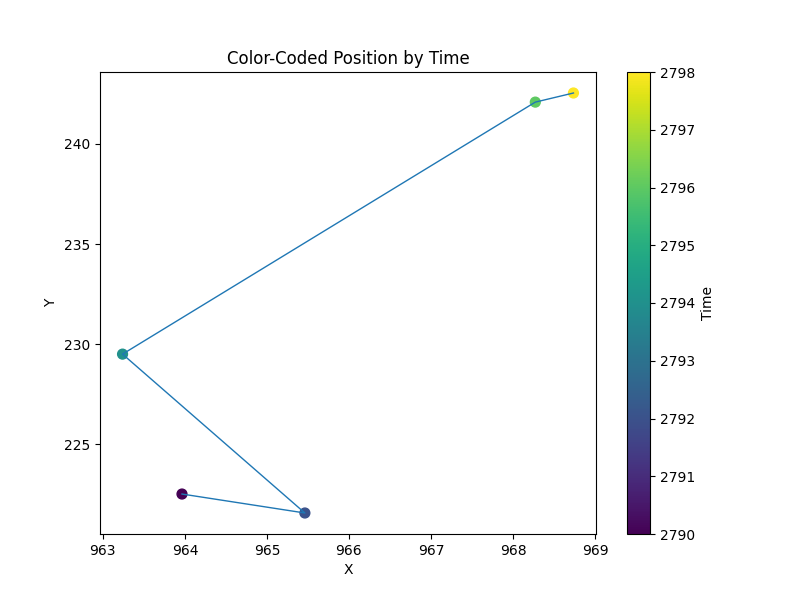

In [179]:
importlib.reload(AllF)
st,end = AllF.closest_index(MegaData[d,:L[d],11], 2790),AllF.closest_index(MegaData[d,:L[d],11], 2800)
print(st)
print(end)
AllF.plot_points_timecolored(MegaData[d,st:end,55],MegaData[d,st:end,56],MegaData[d,st:end,11],lines=True)